# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

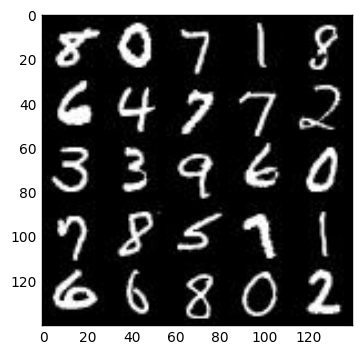

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

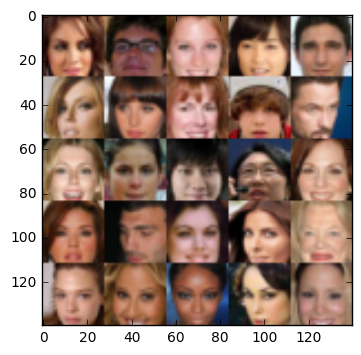

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    real_input = tf.placeholder(tf.float32, shape=(None, image_width, image_height, image_channels))
    z = tf.placeholder(tf.float32, shape=(None, z_dim))
    learning_rate = tf.placeholder(tf.float32)
    
    return real_input, z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    alpha = 0.1
    
    with tf.variable_scope("discriminator", reuse=reuse):
        conv1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        conv1 = tf.maximum(alpha * conv1, conv1)
        
        conv2 = tf.layers.conv2d(conv1, 128, 5, strides=2, padding='same')
        conv2 = tf.layers.batch_normalization(conv2,  training=True)
        conv2 = tf.maximum(alpha * conv2, conv2)
        
        conv3 = tf.layers.conv2d(conv2, 256, 5, strides=2, padding='same')
        conv3 = tf.layers.batch_normalization(conv3,  training=True)
        conv3 = tf.maximum(alpha * conv3, conv3)

        flat  = tf.reshape(conv3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    alpha = 0.1
    
    with tf.variable_scope("generator", reuse=not is_train):
        x = tf.layers.dense(z, 7*7*512)
        x = tf.reshape(x, (-1, 7, 7, 512))
        x = tf.layers.batch_normalization(x, training=is_train)
        x = tf.maximum(alpha * x, x)
        
        conv1 = tf.layers.conv2d_transpose(x, 256, 5, strides=1, padding="same")
        conv1 = tf.layers.batch_normalization(conv1, training=is_train)
        conv1 = tf.maximum(alpha * conv1, conv1)
        
        conv2 = tf.layers.conv2d_transpose(conv1, 128, 5, strides=2, padding="same")
        conv2 = tf.layers.batch_normalization(conv2, training=is_train)
        conv2 = tf.maximum(alpha * conv2, conv2)
        
        logits = tf.layers.conv2d_transpose(conv2, out_channel_dim, 5, strides=2, padding="same")
        out = tf.tanh(logits)
    
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, out_channel_dim, is_train=True)
    
    d_model_real, d_logits_real = discriminator(input_real, reuse=False)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_real)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))
    d_loss = d_loss_real + d_loss_fake
    return d_loss, g_loss

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    
    d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)): 
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    n_samples, width, height, channels = data_shape
    input_real, input_z, learn_rate = model_inputs(width, height, channels, z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, channels)
    d_opt, g_opt = model_opt(d_loss, g_loss, learn_rate, beta1)
    
    steps = 0
    show_every = 50
    print_every = 10
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                batch_images *= 2
                steps += 1
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))

                # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z, learn_rate: learning_rate})
                _ = sess.run(g_opt, feed_dict={input_real: batch_images, input_z: batch_z, learn_rate: learning_rate})

                if steps % show_every == 0:
                    n_images = 16
                    show_generator_output(sess, n_images, input_z, channels, data_image_mode)

                if steps % print_every == 0:
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 0/2... Discriminator Loss: 1.8100... Generator Loss: 0.2191
Epoch 0/2... Discriminator Loss: 1.5107... Generator Loss: 0.3423
Epoch 0/2... Discriminator Loss: 1.3582... Generator Loss: 0.4640
Epoch 0/2... Discriminator Loss: 0.3815... Generator Loss: 1.9681


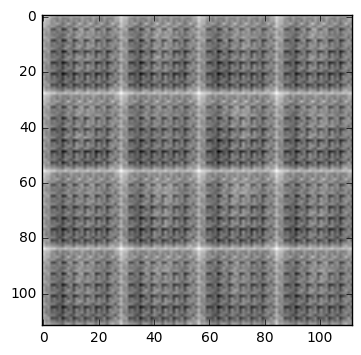

Epoch 0/2... Discriminator Loss: 0.2116... Generator Loss: 3.1827
Epoch 0/2... Discriminator Loss: 0.5483... Generator Loss: 4.6568
Epoch 0/2... Discriminator Loss: 0.9910... Generator Loss: 1.0206
Epoch 0/2... Discriminator Loss: 0.9911... Generator Loss: 1.4671
Epoch 0/2... Discriminator Loss: 1.3238... Generator Loss: 0.5233


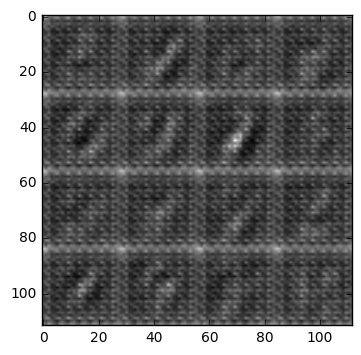

Epoch 0/2... Discriminator Loss: 1.2193... Generator Loss: 1.3241
Epoch 0/2... Discriminator Loss: 1.3183... Generator Loss: 0.4894
Epoch 0/2... Discriminator Loss: 0.9975... Generator Loss: 1.0629
Epoch 0/2... Discriminator Loss: 1.3582... Generator Loss: 1.3060
Epoch 0/2... Discriminator Loss: 1.7289... Generator Loss: 0.3245


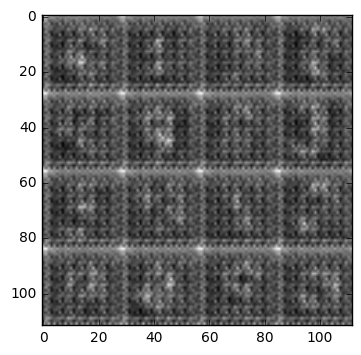

Epoch 0/2... Discriminator Loss: 1.4723... Generator Loss: 0.4401
Epoch 0/2... Discriminator Loss: 1.3499... Generator Loss: 1.7248
Epoch 0/2... Discriminator Loss: 1.3444... Generator Loss: 0.4363
Epoch 0/2... Discriminator Loss: 1.4289... Generator Loss: 0.4479
Epoch 0/2... Discriminator Loss: 1.0006... Generator Loss: 1.0365


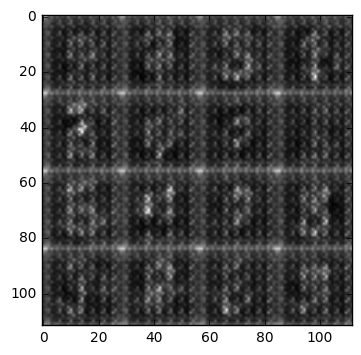

Epoch 0/2... Discriminator Loss: 1.3753... Generator Loss: 0.4340
Epoch 0/2... Discriminator Loss: 0.8518... Generator Loss: 1.1670
Epoch 0/2... Discriminator Loss: 1.1221... Generator Loss: 1.0717
Epoch 0/2... Discriminator Loss: 0.9517... Generator Loss: 1.1295
Epoch 0/2... Discriminator Loss: 0.9424... Generator Loss: 0.9093


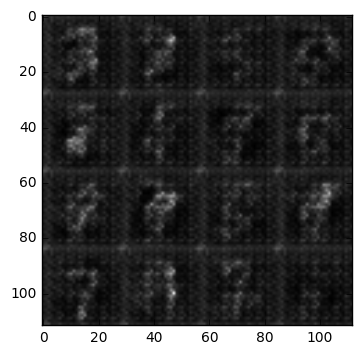

Epoch 0/2... Discriminator Loss: 1.0919... Generator Loss: 0.6807
Epoch 0/2... Discriminator Loss: 1.1326... Generator Loss: 0.6193
Epoch 0/2... Discriminator Loss: 1.2578... Generator Loss: 0.4362
Epoch 0/2... Discriminator Loss: 1.0004... Generator Loss: 0.9257
Epoch 0/2... Discriminator Loss: 1.1517... Generator Loss: 0.5920


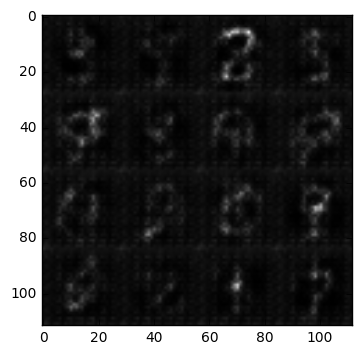

Epoch 0/2... Discriminator Loss: 1.1396... Generator Loss: 0.6160
Epoch 0/2... Discriminator Loss: 0.9705... Generator Loss: 1.1040
Epoch 0/2... Discriminator Loss: 1.0145... Generator Loss: 1.0741
Epoch 0/2... Discriminator Loss: 1.2956... Generator Loss: 0.4652
Epoch 0/2... Discriminator Loss: 0.9647... Generator Loss: 0.7452


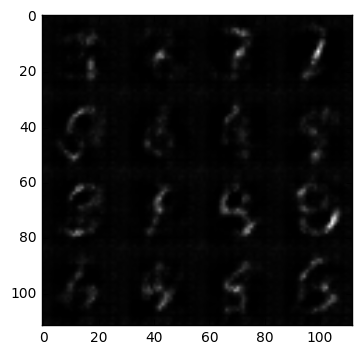

Epoch 0/2... Discriminator Loss: 1.0408... Generator Loss: 0.6427
Epoch 0/2... Discriminator Loss: 1.4439... Generator Loss: 0.4124
Epoch 0/2... Discriminator Loss: 1.0581... Generator Loss: 1.6841
Epoch 0/2... Discriminator Loss: 0.9326... Generator Loss: 0.8798
Epoch 0/2... Discriminator Loss: 1.2070... Generator Loss: 1.5943


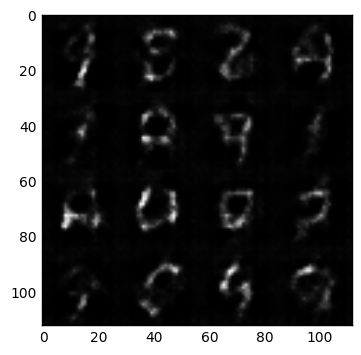

Epoch 0/2... Discriminator Loss: 0.8587... Generator Loss: 1.2737
Epoch 0/2... Discriminator Loss: 0.9950... Generator Loss: 0.6391
Epoch 0/2... Discriminator Loss: 1.0011... Generator Loss: 0.8271
Epoch 0/2... Discriminator Loss: 1.0987... Generator Loss: 0.8112
Epoch 0/2... Discriminator Loss: 0.9681... Generator Loss: 1.9635


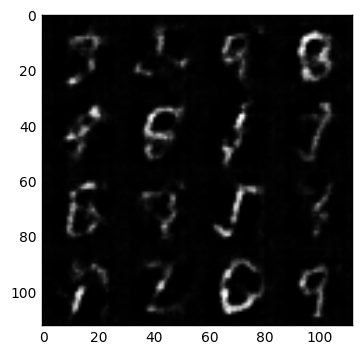

Epoch 0/2... Discriminator Loss: 1.1145... Generator Loss: 0.7837
Epoch 0/2... Discriminator Loss: 0.9429... Generator Loss: 1.3148
Epoch 0/2... Discriminator Loss: 1.5541... Generator Loss: 0.3116
Epoch 0/2... Discriminator Loss: 1.4294... Generator Loss: 0.3625
Epoch 0/2... Discriminator Loss: 1.0929... Generator Loss: 1.7766


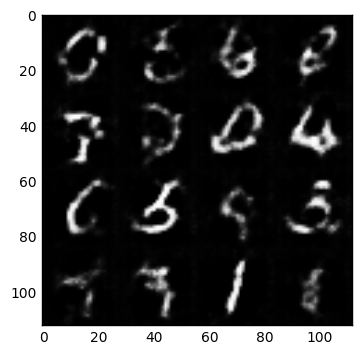

Epoch 0/2... Discriminator Loss: 0.9579... Generator Loss: 1.1858
Epoch 0/2... Discriminator Loss: 1.0491... Generator Loss: 0.9114
Epoch 0/2... Discriminator Loss: 1.1240... Generator Loss: 0.7223
Epoch 0/2... Discriminator Loss: 1.2171... Generator Loss: 0.4584
Epoch 0/2... Discriminator Loss: 0.9825... Generator Loss: 0.8420


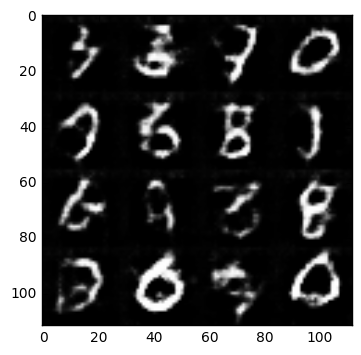

Epoch 0/2... Discriminator Loss: 0.8911... Generator Loss: 0.8530
Epoch 0/2... Discriminator Loss: 1.2035... Generator Loss: 1.5782
Epoch 0/2... Discriminator Loss: 1.0268... Generator Loss: 0.9826
Epoch 0/2... Discriminator Loss: 1.1142... Generator Loss: 0.6159
Epoch 0/2... Discriminator Loss: 1.0476... Generator Loss: 0.7943


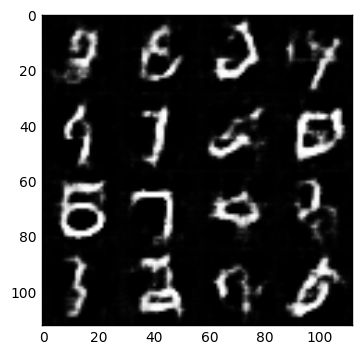

Epoch 0/2... Discriminator Loss: 1.0163... Generator Loss: 0.8582
Epoch 0/2... Discriminator Loss: 1.4528... Generator Loss: 0.3809
Epoch 0/2... Discriminator Loss: 0.9785... Generator Loss: 0.6465
Epoch 0/2... Discriminator Loss: 1.0384... Generator Loss: 0.7047
Epoch 0/2... Discriminator Loss: 0.8546... Generator Loss: 0.9693


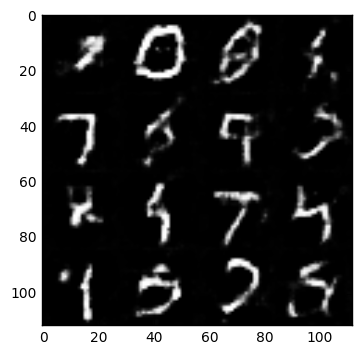

Epoch 0/2... Discriminator Loss: 1.2115... Generator Loss: 1.0859
Epoch 0/2... Discriminator Loss: 0.7635... Generator Loss: 1.6184
Epoch 0/2... Discriminator Loss: 1.1084... Generator Loss: 0.6864
Epoch 0/2... Discriminator Loss: 0.9285... Generator Loss: 1.0084
Epoch 0/2... Discriminator Loss: 1.0181... Generator Loss: 1.0362


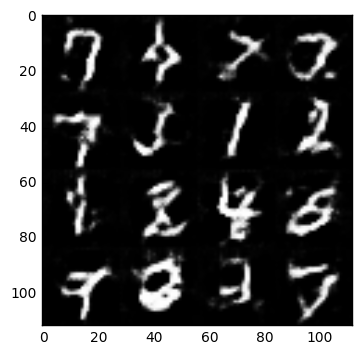

Epoch 0/2... Discriminator Loss: 0.8506... Generator Loss: 1.2208
Epoch 0/2... Discriminator Loss: 1.1060... Generator Loss: 0.5900
Epoch 0/2... Discriminator Loss: 0.9378... Generator Loss: 1.3108
Epoch 0/2... Discriminator Loss: 1.3236... Generator Loss: 0.4815
Epoch 0/2... Discriminator Loss: 1.0590... Generator Loss: 0.6321


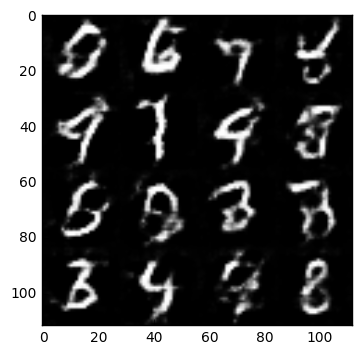

Epoch 0/2... Discriminator Loss: 1.0193... Generator Loss: 0.6959
Epoch 0/2... Discriminator Loss: 1.0353... Generator Loss: 1.0837
Epoch 0/2... Discriminator Loss: 1.0310... Generator Loss: 0.6354
Epoch 0/2... Discriminator Loss: 0.9361... Generator Loss: 0.9535
Epoch 0/2... Discriminator Loss: 1.0964... Generator Loss: 0.6793


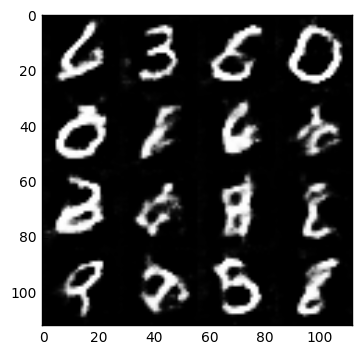

Epoch 0/2... Discriminator Loss: 0.9045... Generator Loss: 0.8668
Epoch 0/2... Discriminator Loss: 0.8723... Generator Loss: 1.2333
Epoch 0/2... Discriminator Loss: 0.9012... Generator Loss: 1.0138
Epoch 0/2... Discriminator Loss: 0.9255... Generator Loss: 0.8151
Epoch 0/2... Discriminator Loss: 1.0122... Generator Loss: 0.6903


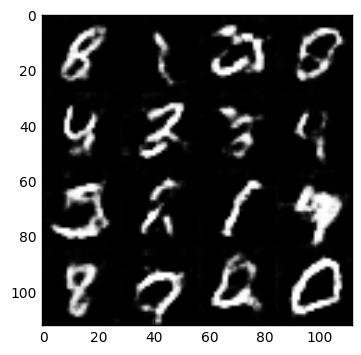

Epoch 0/2... Discriminator Loss: 1.0606... Generator Loss: 0.6112
Epoch 0/2... Discriminator Loss: 1.0601... Generator Loss: 0.6050
Epoch 0/2... Discriminator Loss: 1.1541... Generator Loss: 0.5244
Epoch 0/2... Discriminator Loss: 1.1387... Generator Loss: 0.7778
Epoch 0/2... Discriminator Loss: 1.0439... Generator Loss: 0.6533


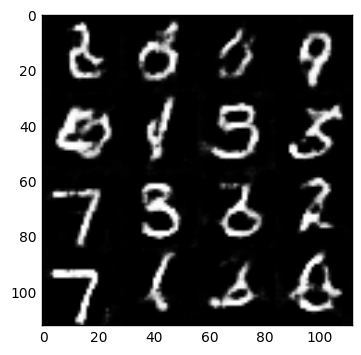

Epoch 0/2... Discriminator Loss: 0.8741... Generator Loss: 0.9023
Epoch 0/2... Discriminator Loss: 1.2822... Generator Loss: 0.4719
Epoch 0/2... Discriminator Loss: 0.8688... Generator Loss: 0.7366
Epoch 0/2... Discriminator Loss: 0.7844... Generator Loss: 1.1870
Epoch 0/2... Discriminator Loss: 1.1484... Generator Loss: 0.5577


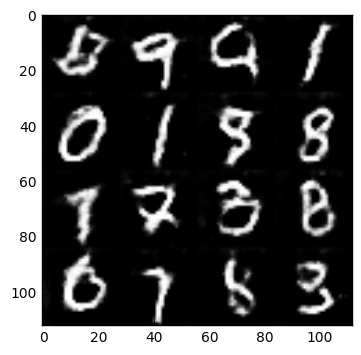

Epoch 0/2... Discriminator Loss: 0.8887... Generator Loss: 1.0661
Epoch 0/2... Discriminator Loss: 0.8824... Generator Loss: 0.7809
Epoch 0/2... Discriminator Loss: 1.4381... Generator Loss: 0.3807
Epoch 0/2... Discriminator Loss: 1.0190... Generator Loss: 0.6386
Epoch 0/2... Discriminator Loss: 0.7661... Generator Loss: 1.1759


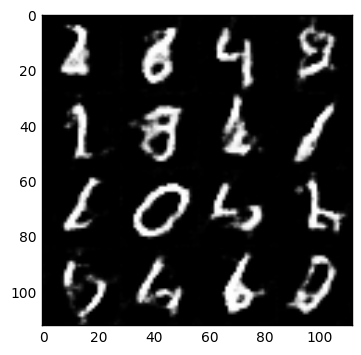

Epoch 0/2... Discriminator Loss: 2.1527... Generator Loss: 0.1519
Epoch 0/2... Discriminator Loss: 0.9267... Generator Loss: 1.5699
Epoch 0/2... Discriminator Loss: 0.7411... Generator Loss: 0.9507
Epoch 0/2... Discriminator Loss: 0.9775... Generator Loss: 1.0536
Epoch 0/2... Discriminator Loss: 1.0875... Generator Loss: 0.5914


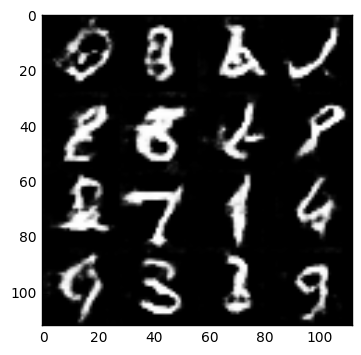

Epoch 0/2... Discriminator Loss: 0.9147... Generator Loss: 0.8083
Epoch 0/2... Discriminator Loss: 1.1026... Generator Loss: 0.5733
Epoch 0/2... Discriminator Loss: 0.9015... Generator Loss: 1.0047
Epoch 0/2... Discriminator Loss: 0.8296... Generator Loss: 0.9769
Epoch 0/2... Discriminator Loss: 0.9887... Generator Loss: 0.6442


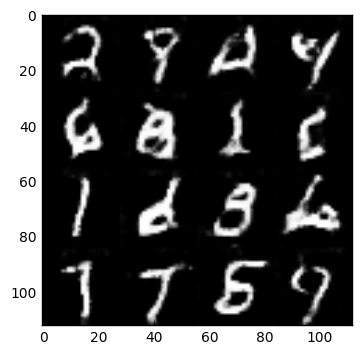

Epoch 0/2... Discriminator Loss: 1.0175... Generator Loss: 0.6250
Epoch 0/2... Discriminator Loss: 0.8917... Generator Loss: 0.8659
Epoch 0/2... Discriminator Loss: 3.3245... Generator Loss: 0.0565
Epoch 0/2... Discriminator Loss: 1.0129... Generator Loss: 0.6545
Epoch 0/2... Discriminator Loss: 0.9230... Generator Loss: 0.9196


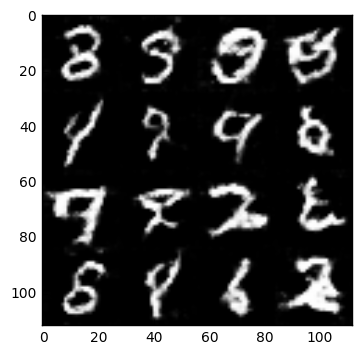

Epoch 0/2... Discriminator Loss: 0.6547... Generator Loss: 1.4551
Epoch 0/2... Discriminator Loss: 0.9575... Generator Loss: 0.7313
Epoch 0/2... Discriminator Loss: 0.9343... Generator Loss: 0.7017
Epoch 0/2... Discriminator Loss: 0.9540... Generator Loss: 0.7383
Epoch 0/2... Discriminator Loss: 0.9243... Generator Loss: 1.1742


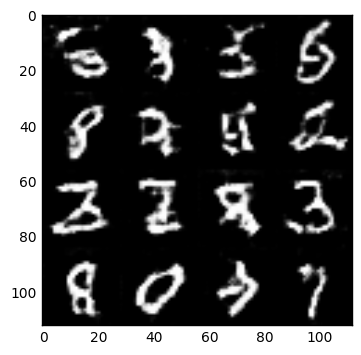

Epoch 0/2... Discriminator Loss: 0.9018... Generator Loss: 1.0372
Epoch 0/2... Discriminator Loss: 1.0236... Generator Loss: 0.7216
Epoch 0/2... Discriminator Loss: 0.6876... Generator Loss: 1.1833
Epoch 0/2... Discriminator Loss: 0.9272... Generator Loss: 0.6595
Epoch 0/2... Discriminator Loss: 0.7562... Generator Loss: 1.0772


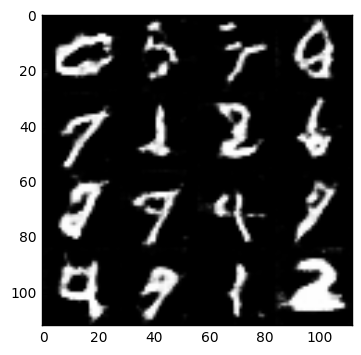

Epoch 0/2... Discriminator Loss: 0.7030... Generator Loss: 1.9564
Epoch 0/2... Discriminator Loss: 1.4903... Generator Loss: 0.3811
Epoch 0/2... Discriminator Loss: 0.5215... Generator Loss: 1.6831
Epoch 0/2... Discriminator Loss: 1.0082... Generator Loss: 1.0318
Epoch 0/2... Discriminator Loss: 1.0198... Generator Loss: 0.6737


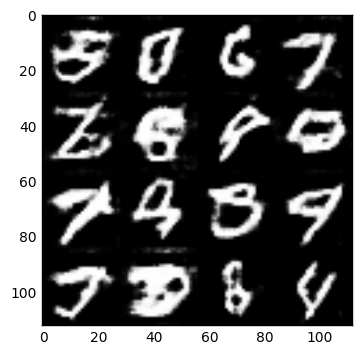

Epoch 0/2... Discriminator Loss: 0.8268... Generator Loss: 0.8293
Epoch 0/2... Discriminator Loss: 1.3808... Generator Loss: 0.4049
Epoch 0/2... Discriminator Loss: 0.5884... Generator Loss: 1.3013
Epoch 0/2... Discriminator Loss: 1.3807... Generator Loss: 0.4041
Epoch 0/2... Discriminator Loss: 0.8842... Generator Loss: 0.9065


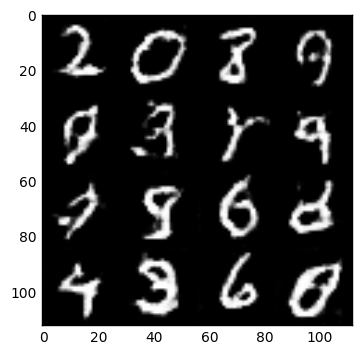

Epoch 0/2... Discriminator Loss: 0.8852... Generator Loss: 0.7746
Epoch 0/2... Discriminator Loss: 1.0209... Generator Loss: 0.6657
Epoch 0/2... Discriminator Loss: 0.9705... Generator Loss: 2.2549
Epoch 0/2... Discriminator Loss: 1.0349... Generator Loss: 0.6785
Epoch 0/2... Discriminator Loss: 0.8468... Generator Loss: 0.8331


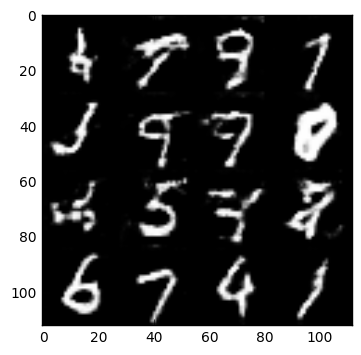

Epoch 0/2... Discriminator Loss: 0.7706... Generator Loss: 0.9605
Epoch 0/2... Discriminator Loss: 0.5838... Generator Loss: 1.3821
Epoch 0/2... Discriminator Loss: 1.0086... Generator Loss: 0.7279
Epoch 0/2... Discriminator Loss: 0.8417... Generator Loss: 0.7892
Epoch 0/2... Discriminator Loss: 0.8019... Generator Loss: 2.0196


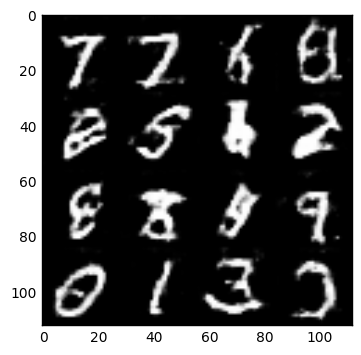

Epoch 0/2... Discriminator Loss: 1.0209... Generator Loss: 0.6444
Epoch 0/2... Discriminator Loss: 0.8480... Generator Loss: 0.7123
Epoch 0/2... Discriminator Loss: 0.8705... Generator Loss: 0.8937
Epoch 0/2... Discriminator Loss: 0.6866... Generator Loss: 1.0569
Epoch 0/2... Discriminator Loss: 0.8913... Generator Loss: 0.7271


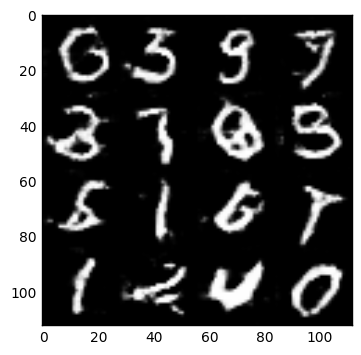

Epoch 0/2... Discriminator Loss: 0.6494... Generator Loss: 1.0328
Epoch 0/2... Discriminator Loss: 0.8438... Generator Loss: 0.7658
Epoch 0/2... Discriminator Loss: 0.8383... Generator Loss: 0.8212
Epoch 0/2... Discriminator Loss: 1.8864... Generator Loss: 0.2186
Epoch 0/2... Discriminator Loss: 0.8113... Generator Loss: 1.2258


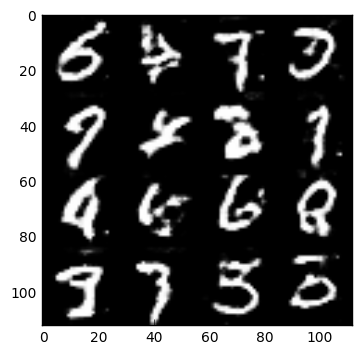

Epoch 0/2... Discriminator Loss: 0.7015... Generator Loss: 1.6123
Epoch 0/2... Discriminator Loss: 1.3506... Generator Loss: 0.4243
Epoch 0/2... Discriminator Loss: 0.6790... Generator Loss: 1.4876
Epoch 0/2... Discriminator Loss: 0.6699... Generator Loss: 1.1470
Epoch 0/2... Discriminator Loss: 0.5496... Generator Loss: 1.5000


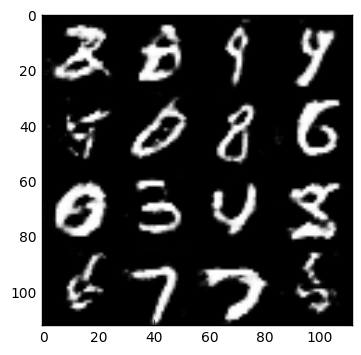

Epoch 0/2... Discriminator Loss: 0.6657... Generator Loss: 1.3528
Epoch 0/2... Discriminator Loss: 0.6264... Generator Loss: 1.1145
Epoch 0/2... Discriminator Loss: 0.9144... Generator Loss: 0.8090
Epoch 0/2... Discriminator Loss: 0.5426... Generator Loss: 1.1430
Epoch 0/2... Discriminator Loss: 0.8193... Generator Loss: 0.8617


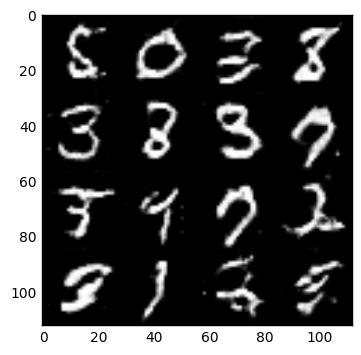

Epoch 0/2... Discriminator Loss: 0.6428... Generator Loss: 2.2087
Epoch 0/2... Discriminator Loss: 1.0013... Generator Loss: 0.8693
Epoch 0/2... Discriminator Loss: 0.7743... Generator Loss: 0.8763
Epoch 0/2... Discriminator Loss: 1.1427... Generator Loss: 0.5363
Epoch 0/2... Discriminator Loss: 1.2914... Generator Loss: 0.4038


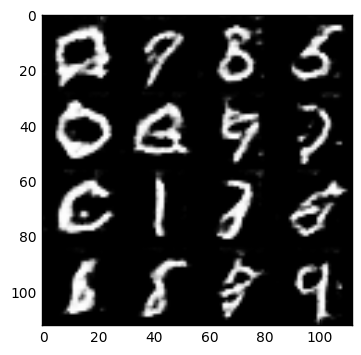

Epoch 0/2... Discriminator Loss: 0.7239... Generator Loss: 1.0215
Epoch 0/2... Discriminator Loss: 0.9052... Generator Loss: 0.6798
Epoch 0/2... Discriminator Loss: 0.9004... Generator Loss: 0.6310
Epoch 0/2... Discriminator Loss: 0.6090... Generator Loss: 2.9442
Epoch 0/2... Discriminator Loss: 1.2721... Generator Loss: 0.4830


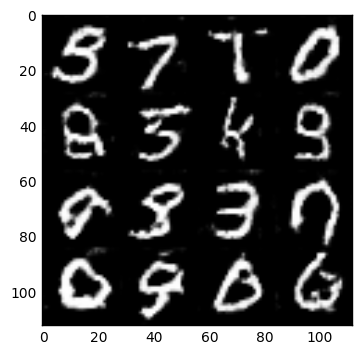

Epoch 0/2... Discriminator Loss: 1.0997... Generator Loss: 0.5530
Epoch 0/2... Discriminator Loss: 0.6741... Generator Loss: 1.1762
Epoch 0/2... Discriminator Loss: 0.8908... Generator Loss: 0.8481
Epoch 0/2... Discriminator Loss: 0.5741... Generator Loss: 1.1813
Epoch 0/2... Discriminator Loss: 0.6178... Generator Loss: 1.9502


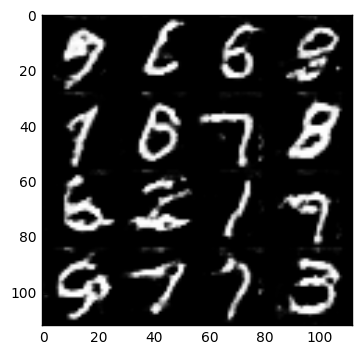

Epoch 0/2... Discriminator Loss: 0.6605... Generator Loss: 0.9896
Epoch 0/2... Discriminator Loss: 0.9490... Generator Loss: 0.8070
Epoch 0/2... Discriminator Loss: 0.7148... Generator Loss: 0.8811
Epoch 0/2... Discriminator Loss: 1.5377... Generator Loss: 0.3674
Epoch 0/2... Discriminator Loss: 0.8011... Generator Loss: 0.9047


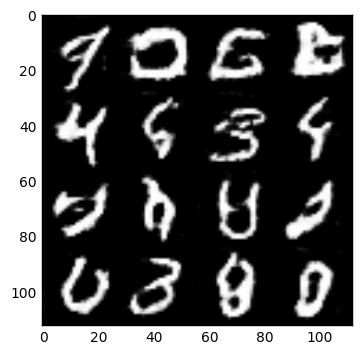

Epoch 0/2... Discriminator Loss: 1.3651... Generator Loss: 0.4128
Epoch 0/2... Discriminator Loss: 0.9310... Generator Loss: 0.7471
Epoch 0/2... Discriminator Loss: 0.5843... Generator Loss: 1.1737
Epoch 1/2... Discriminator Loss: 0.4646... Generator Loss: 1.3865
Epoch 1/2... Discriminator Loss: 0.8455... Generator Loss: 0.8391


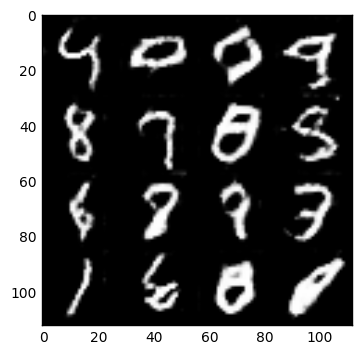

Epoch 1/2... Discriminator Loss: 1.9974... Generator Loss: 3.7790
Epoch 1/2... Discriminator Loss: 0.7043... Generator Loss: 1.3296
Epoch 1/2... Discriminator Loss: 0.4292... Generator Loss: 1.5908
Epoch 1/2... Discriminator Loss: 0.7056... Generator Loss: 0.9720
Epoch 1/2... Discriminator Loss: 1.1014... Generator Loss: 2.7108


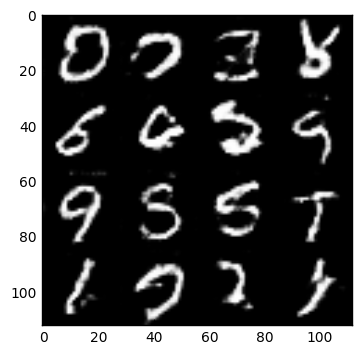

Epoch 1/2... Discriminator Loss: 0.6083... Generator Loss: 1.2203
Epoch 1/2... Discriminator Loss: 0.9007... Generator Loss: 0.7028
Epoch 1/2... Discriminator Loss: 0.4893... Generator Loss: 1.2956
Epoch 1/2... Discriminator Loss: 1.2347... Generator Loss: 0.4869
Epoch 1/2... Discriminator Loss: 0.7376... Generator Loss: 3.0715


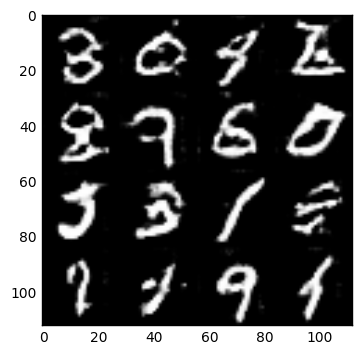

Epoch 1/2... Discriminator Loss: 0.6077... Generator Loss: 1.3414
Epoch 1/2... Discriminator Loss: 0.7641... Generator Loss: 0.9394
Epoch 1/2... Discriminator Loss: 0.9109... Generator Loss: 0.7882
Epoch 1/2... Discriminator Loss: 0.9986... Generator Loss: 0.6555
Epoch 1/2... Discriminator Loss: 1.0939... Generator Loss: 0.5757


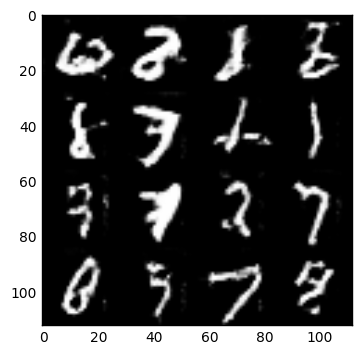

Epoch 1/2... Discriminator Loss: 0.4359... Generator Loss: 1.8117
Epoch 1/2... Discriminator Loss: 0.9018... Generator Loss: 1.0754
Epoch 1/2... Discriminator Loss: 1.2149... Generator Loss: 0.4993
Epoch 1/2... Discriminator Loss: 0.4846... Generator Loss: 1.3529
Epoch 1/2... Discriminator Loss: 0.7114... Generator Loss: 1.1951


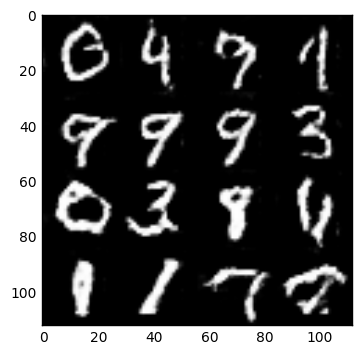

Epoch 1/2... Discriminator Loss: 1.1062... Generator Loss: 0.5765
Epoch 1/2... Discriminator Loss: 0.7144... Generator Loss: 1.0992
Epoch 1/2... Discriminator Loss: 0.7065... Generator Loss: 1.0047
Epoch 1/2... Discriminator Loss: 1.0013... Generator Loss: 2.9188
Epoch 1/2... Discriminator Loss: 0.7261... Generator Loss: 1.4764


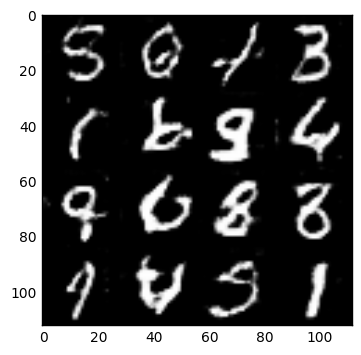

Epoch 1/2... Discriminator Loss: 0.9437... Generator Loss: 0.7176
Epoch 1/2... Discriminator Loss: 0.8161... Generator Loss: 0.8840
Epoch 1/2... Discriminator Loss: 0.5631... Generator Loss: 2.1531
Epoch 1/2... Discriminator Loss: 0.6388... Generator Loss: 1.1087
Epoch 1/2... Discriminator Loss: 0.4826... Generator Loss: 2.1235


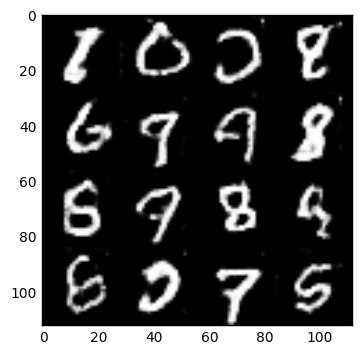

Epoch 1/2... Discriminator Loss: 0.8369... Generator Loss: 0.9187
Epoch 1/2... Discriminator Loss: 1.6561... Generator Loss: 3.2416
Epoch 1/2... Discriminator Loss: 0.6478... Generator Loss: 1.1613
Epoch 1/2... Discriminator Loss: 0.6852... Generator Loss: 0.9863
Epoch 1/2... Discriminator Loss: 0.7677... Generator Loss: 0.8385


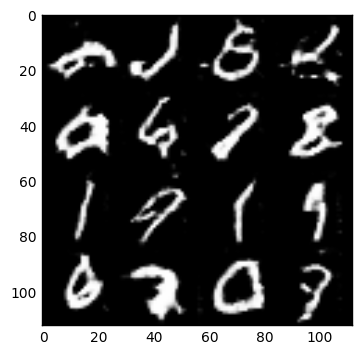

Epoch 1/2... Discriminator Loss: 0.6199... Generator Loss: 1.2438
Epoch 1/2... Discriminator Loss: 1.2999... Generator Loss: 0.4124
Epoch 1/2... Discriminator Loss: 1.5157... Generator Loss: 0.3559
Epoch 1/2... Discriminator Loss: 0.9101... Generator Loss: 0.7737
Epoch 1/2... Discriminator Loss: 0.8831... Generator Loss: 0.7262


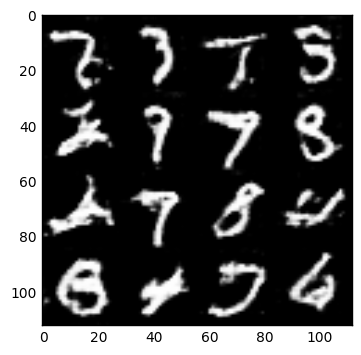

Epoch 1/2... Discriminator Loss: 0.7522... Generator Loss: 0.9019
Epoch 1/2... Discriminator Loss: 0.6535... Generator Loss: 1.0786
Epoch 1/2... Discriminator Loss: 0.8737... Generator Loss: 0.7061
Epoch 1/2... Discriminator Loss: 0.7004... Generator Loss: 1.0718
Epoch 1/2... Discriminator Loss: 1.0335... Generator Loss: 0.7970


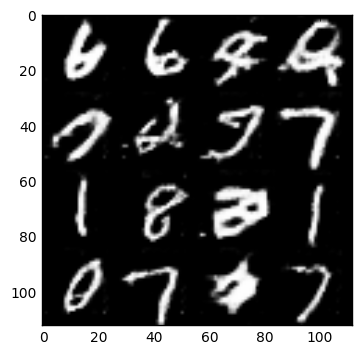

Epoch 1/2... Discriminator Loss: 0.6461... Generator Loss: 1.0425
Epoch 1/2... Discriminator Loss: 0.6276... Generator Loss: 1.1912
Epoch 1/2... Discriminator Loss: 1.2046... Generator Loss: 0.5469
Epoch 1/2... Discriminator Loss: 0.8461... Generator Loss: 0.7789
Epoch 1/2... Discriminator Loss: 0.7536... Generator Loss: 0.9528


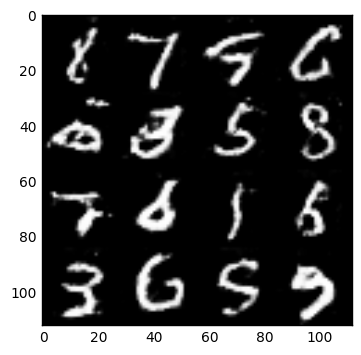

Epoch 1/2... Discriminator Loss: 1.0184... Generator Loss: 0.6399
Epoch 1/2... Discriminator Loss: 1.3079... Generator Loss: 0.4567
Epoch 1/2... Discriminator Loss: 0.7632... Generator Loss: 0.8222
Epoch 1/2... Discriminator Loss: 0.6484... Generator Loss: 0.9606
Epoch 1/2... Discriminator Loss: 0.3614... Generator Loss: 1.9133


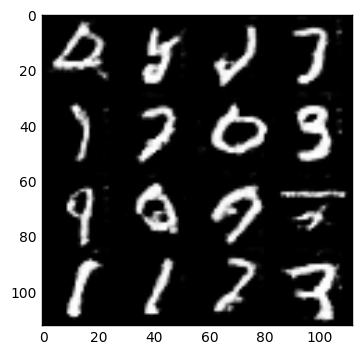

Epoch 1/2... Discriminator Loss: 0.4569... Generator Loss: 1.4833
Epoch 1/2... Discriminator Loss: 0.7317... Generator Loss: 1.0063
Epoch 1/2... Discriminator Loss: 2.2165... Generator Loss: 5.0340
Epoch 1/2... Discriminator Loss: 0.7729... Generator Loss: 0.9979
Epoch 1/2... Discriminator Loss: 0.9969... Generator Loss: 0.7130


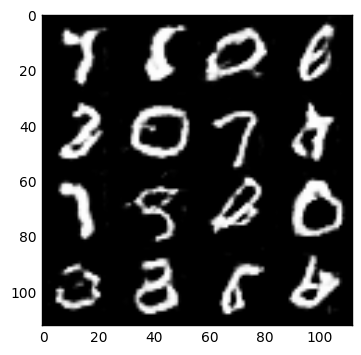

Epoch 1/2... Discriminator Loss: 0.5103... Generator Loss: 2.1454
Epoch 1/2... Discriminator Loss: 0.8832... Generator Loss: 0.7750
Epoch 1/2... Discriminator Loss: 1.0545... Generator Loss: 0.5784
Epoch 1/2... Discriminator Loss: 0.4952... Generator Loss: 1.3310
Epoch 1/2... Discriminator Loss: 0.6624... Generator Loss: 1.0335


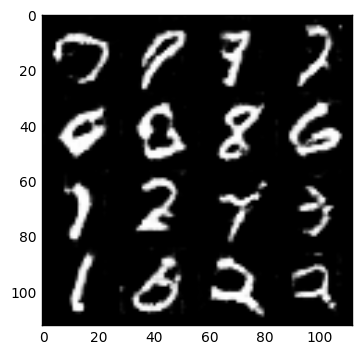

Epoch 1/2... Discriminator Loss: 0.5128... Generator Loss: 1.3947
Epoch 1/2... Discriminator Loss: 0.5852... Generator Loss: 1.0721
Epoch 1/2... Discriminator Loss: 0.6782... Generator Loss: 0.9553
Epoch 1/2... Discriminator Loss: 0.5286... Generator Loss: 1.1542
Epoch 1/2... Discriminator Loss: 1.9721... Generator Loss: 0.2771


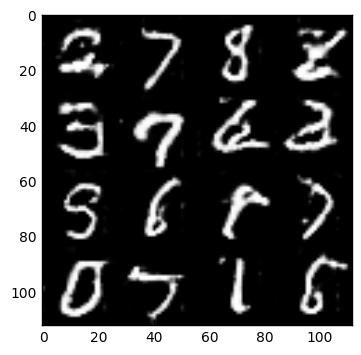

Epoch 1/2... Discriminator Loss: 0.9176... Generator Loss: 0.8043
Epoch 1/2... Discriminator Loss: 0.4564... Generator Loss: 1.7030
Epoch 1/2... Discriminator Loss: 0.7728... Generator Loss: 0.9776
Epoch 1/2... Discriminator Loss: 0.9264... Generator Loss: 0.8335
Epoch 1/2... Discriminator Loss: 0.3877... Generator Loss: 2.3057


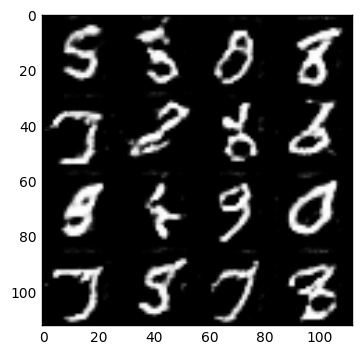

Epoch 1/2... Discriminator Loss: 0.5142... Generator Loss: 1.4507
Epoch 1/2... Discriminator Loss: 0.4154... Generator Loss: 1.7250
Epoch 1/2... Discriminator Loss: 1.0946... Generator Loss: 0.6176
Epoch 1/2... Discriminator Loss: 0.3315... Generator Loss: 2.4951
Epoch 1/2... Discriminator Loss: 0.7679... Generator Loss: 1.1053


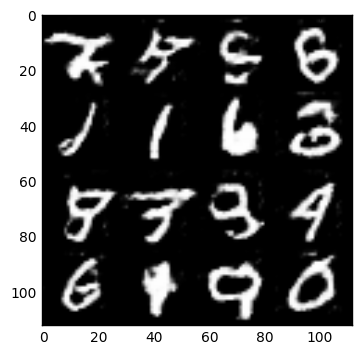

Epoch 1/2... Discriminator Loss: 0.6652... Generator Loss: 2.0886
Epoch 1/2... Discriminator Loss: 0.4715... Generator Loss: 1.3199
Epoch 1/2... Discriminator Loss: 0.5257... Generator Loss: 1.8951
Epoch 1/2... Discriminator Loss: 0.5069... Generator Loss: 1.3520
Epoch 1/2... Discriminator Loss: 1.4352... Generator Loss: 0.3776


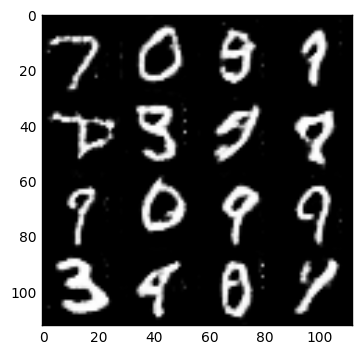

Epoch 1/2... Discriminator Loss: 1.4607... Generator Loss: 0.3821
Epoch 1/2... Discriminator Loss: 0.8469... Generator Loss: 0.7754
Epoch 1/2... Discriminator Loss: 1.1980... Generator Loss: 0.6175
Epoch 1/2... Discriminator Loss: 1.2107... Generator Loss: 0.5502
Epoch 1/2... Discriminator Loss: 1.5394... Generator Loss: 0.3139


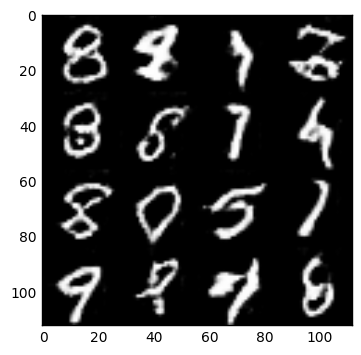

Epoch 1/2... Discriminator Loss: 1.0270... Generator Loss: 0.7509
Epoch 1/2... Discriminator Loss: 0.5135... Generator Loss: 1.2285
Epoch 1/2... Discriminator Loss: 0.4357... Generator Loss: 1.6477
Epoch 1/2... Discriminator Loss: 0.5979... Generator Loss: 1.3659
Epoch 1/2... Discriminator Loss: 0.5858... Generator Loss: 1.1406


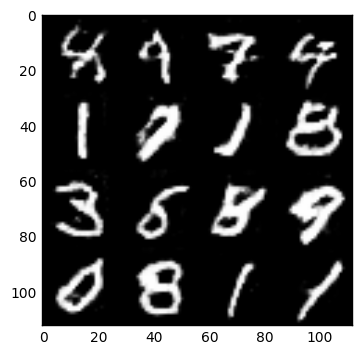

Epoch 1/2... Discriminator Loss: 0.5159... Generator Loss: 1.3353
Epoch 1/2... Discriminator Loss: 0.7156... Generator Loss: 0.9840
Epoch 1/2... Discriminator Loss: 0.5900... Generator Loss: 1.1242
Epoch 1/2... Discriminator Loss: 0.5549... Generator Loss: 1.1448
Epoch 1/2... Discriminator Loss: 2.6666... Generator Loss: 0.1255


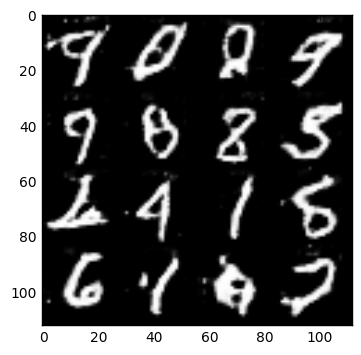

Epoch 1/2... Discriminator Loss: 0.5351... Generator Loss: 1.7279
Epoch 1/2... Discriminator Loss: 0.8299... Generator Loss: 0.8367
Epoch 1/2... Discriminator Loss: 1.1302... Generator Loss: 0.5387
Epoch 1/2... Discriminator Loss: 0.5039... Generator Loss: 1.3334
Epoch 1/2... Discriminator Loss: 0.6232... Generator Loss: 1.1105


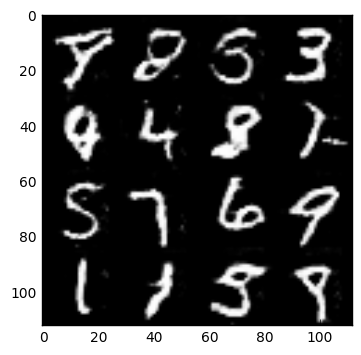

Epoch 1/2... Discriminator Loss: 0.3762... Generator Loss: 1.8006
Epoch 1/2... Discriminator Loss: 0.7056... Generator Loss: 0.8442
Epoch 1/2... Discriminator Loss: 0.3514... Generator Loss: 1.7087
Epoch 1/2... Discriminator Loss: 0.5481... Generator Loss: 1.3746
Epoch 1/2... Discriminator Loss: 1.4060... Generator Loss: 4.3481


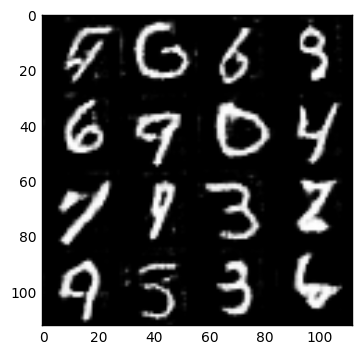

Epoch 1/2... Discriminator Loss: 0.6313... Generator Loss: 1.2091
Epoch 1/2... Discriminator Loss: 0.8278... Generator Loss: 0.8816
Epoch 1/2... Discriminator Loss: 0.3898... Generator Loss: 2.0712
Epoch 1/2... Discriminator Loss: 0.7557... Generator Loss: 1.0167
Epoch 1/2... Discriminator Loss: 1.9147... Generator Loss: 3.8626


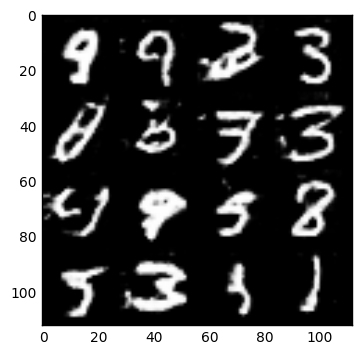

Epoch 1/2... Discriminator Loss: 0.4221... Generator Loss: 1.6135
Epoch 1/2... Discriminator Loss: 0.6993... Generator Loss: 1.0364
Epoch 1/2... Discriminator Loss: 1.2700... Generator Loss: 0.4814
Epoch 1/2... Discriminator Loss: 0.6115... Generator Loss: 1.2010
Epoch 1/2... Discriminator Loss: 0.5652... Generator Loss: 1.1336


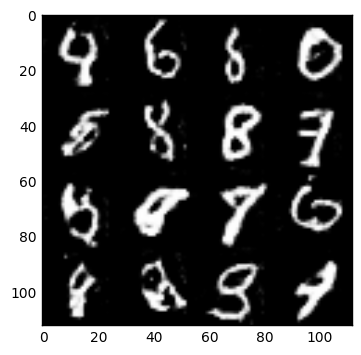

Epoch 1/2... Discriminator Loss: 0.6296... Generator Loss: 1.1194
Epoch 1/2... Discriminator Loss: 0.4183... Generator Loss: 1.6028
Epoch 1/2... Discriminator Loss: 0.5180... Generator Loss: 2.6221
Epoch 1/2... Discriminator Loss: 0.5129... Generator Loss: 2.0914
Epoch 1/2... Discriminator Loss: 0.5095... Generator Loss: 1.4256


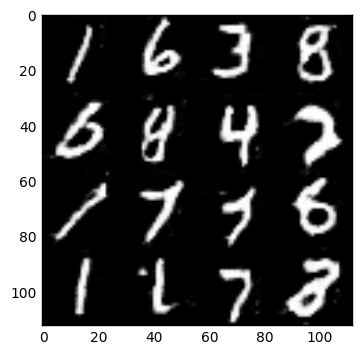

Epoch 1/2... Discriminator Loss: 1.6925... Generator Loss: 0.2663
Epoch 1/2... Discriminator Loss: 0.9924... Generator Loss: 0.6716
Epoch 1/2... Discriminator Loss: 0.9012... Generator Loss: 0.8356
Epoch 1/2... Discriminator Loss: 1.0981... Generator Loss: 0.5989
Epoch 1/2... Discriminator Loss: 0.7085... Generator Loss: 1.0695


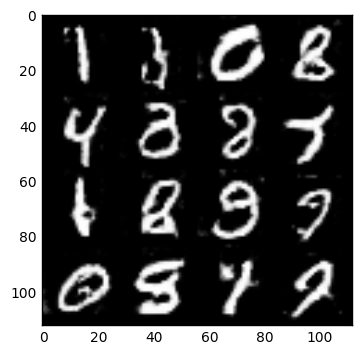

Epoch 1/2... Discriminator Loss: 0.4242... Generator Loss: 1.6383
Epoch 1/2... Discriminator Loss: 0.5432... Generator Loss: 1.9273
Epoch 1/2... Discriminator Loss: 1.3830... Generator Loss: 0.3654
Epoch 1/2... Discriminator Loss: 0.5301... Generator Loss: 1.4664
Epoch 1/2... Discriminator Loss: 0.6535... Generator Loss: 1.0175


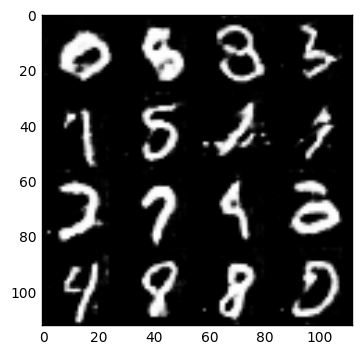

Epoch 1/2... Discriminator Loss: 0.4910... Generator Loss: 1.4081
Epoch 1/2... Discriminator Loss: 1.4944... Generator Loss: 0.3400
Epoch 1/2... Discriminator Loss: 0.2901... Generator Loss: 2.1247
Epoch 1/2... Discriminator Loss: 0.6700... Generator Loss: 1.0772
Epoch 1/2... Discriminator Loss: 0.5088... Generator Loss: 1.2728


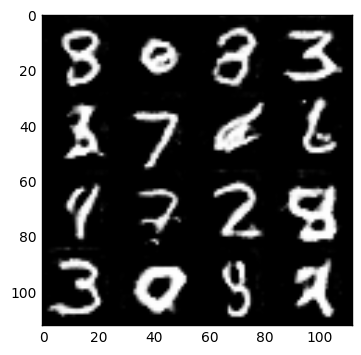

Epoch 1/2... Discriminator Loss: 0.7096... Generator Loss: 0.9054
Epoch 1/2... Discriminator Loss: 0.4920... Generator Loss: 1.3727
Epoch 1/2... Discriminator Loss: 0.3922... Generator Loss: 1.4938
Epoch 1/2... Discriminator Loss: 0.3754... Generator Loss: 2.4830
Epoch 1/2... Discriminator Loss: 0.6870... Generator Loss: 2.6286


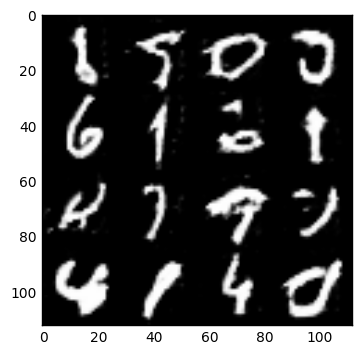

Epoch 1/2... Discriminator Loss: 0.9051... Generator Loss: 0.7564
Epoch 1/2... Discriminator Loss: 0.3855... Generator Loss: 2.0382
Epoch 1/2... Discriminator Loss: 0.8741... Generator Loss: 3.4322
Epoch 1/2... Discriminator Loss: 2.6797... Generator Loss: 0.1712
Epoch 1/2... Discriminator Loss: 0.4530... Generator Loss: 1.5003


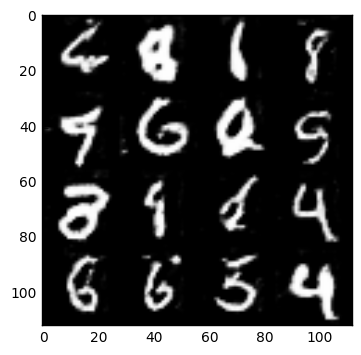

Epoch 1/2... Discriminator Loss: 0.3974... Generator Loss: 2.1344
Epoch 1/2... Discriminator Loss: 0.5590... Generator Loss: 1.1704
Epoch 1/2... Discriminator Loss: 1.6228... Generator Loss: 0.2972
Epoch 1/2... Discriminator Loss: 0.6138... Generator Loss: 1.0647
Epoch 1/2... Discriminator Loss: 0.5226... Generator Loss: 1.3053


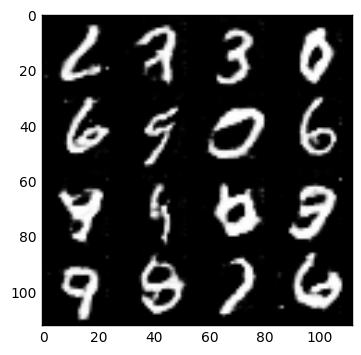

Epoch 1/2... Discriminator Loss: 0.6173... Generator Loss: 1.3456
Epoch 1/2... Discriminator Loss: 0.7967... Generator Loss: 0.8742
Epoch 1/2... Discriminator Loss: 0.7378... Generator Loss: 0.9360
Epoch 1/2... Discriminator Loss: 0.7631... Generator Loss: 0.9715
Epoch 1/2... Discriminator Loss: 0.3589... Generator Loss: 1.8764


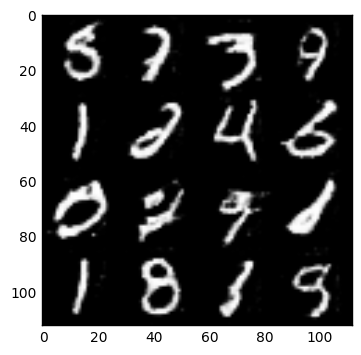

Epoch 1/2... Discriminator Loss: 0.9194... Generator Loss: 2.9136
Epoch 1/2... Discriminator Loss: 1.7812... Generator Loss: 0.2728
Epoch 1/2... Discriminator Loss: 0.4710... Generator Loss: 1.5005
Epoch 1/2... Discriminator Loss: 0.5891... Generator Loss: 1.0904
Epoch 1/2... Discriminator Loss: 1.5696... Generator Loss: 0.3471


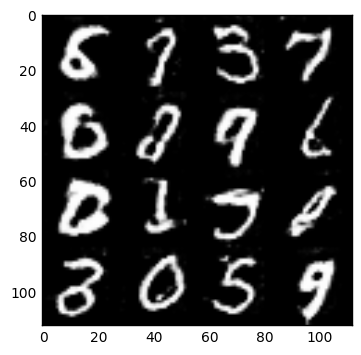

Epoch 1/2... Discriminator Loss: 0.9952... Generator Loss: 0.7451
Epoch 1/2... Discriminator Loss: 0.7661... Generator Loss: 0.8860
Epoch 1/2... Discriminator Loss: 0.6407... Generator Loss: 1.0410
Epoch 1/2... Discriminator Loss: 0.4526... Generator Loss: 1.4346
Epoch 1/2... Discriminator Loss: 0.3200... Generator Loss: 2.0208


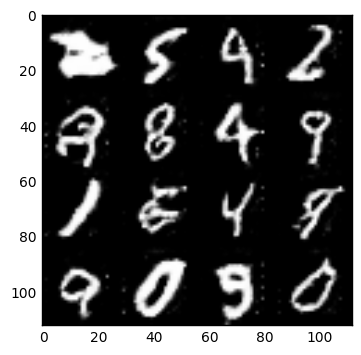

Epoch 1/2... Discriminator Loss: 1.3364... Generator Loss: 0.4055
Epoch 1/2... Discriminator Loss: 0.6676... Generator Loss: 1.4999
Epoch 1/2... Discriminator Loss: 0.7425... Generator Loss: 1.0987
Epoch 1/2... Discriminator Loss: 0.5749... Generator Loss: 2.3805
Epoch 1/2... Discriminator Loss: 0.9383... Generator Loss: 0.7396


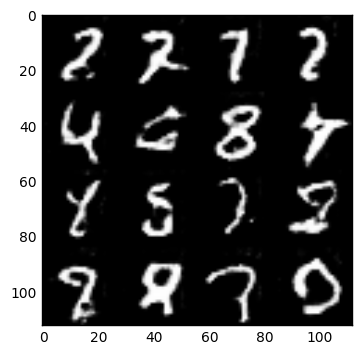

Epoch 1/2... Discriminator Loss: 0.9096... Generator Loss: 0.8140
Epoch 1/2... Discriminator Loss: 1.0421... Generator Loss: 0.6573
Epoch 1/2... Discriminator Loss: 0.3792... Generator Loss: 1.6174
Epoch 1/2... Discriminator Loss: 0.5550... Generator Loss: 1.3099
Epoch 1/2... Discriminator Loss: 0.7092... Generator Loss: 1.0716


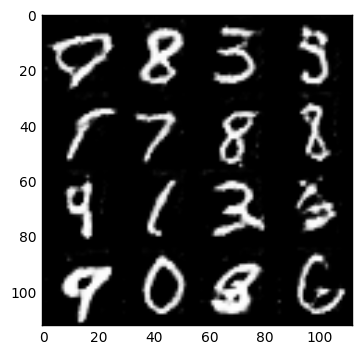

Epoch 1/2... Discriminator Loss: 0.7401... Generator Loss: 0.9134
Epoch 1/2... Discriminator Loss: 0.4733... Generator Loss: 1.3513
Epoch 1/2... Discriminator Loss: 0.5064... Generator Loss: 1.6018
Epoch 1/2... Discriminator Loss: 0.9791... Generator Loss: 0.7009
Epoch 1/2... Discriminator Loss: 1.0521... Generator Loss: 0.5847


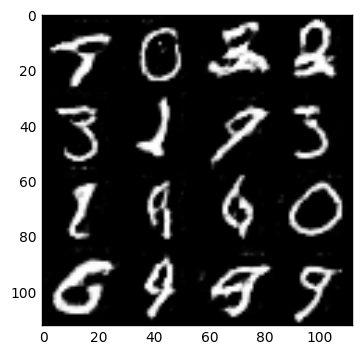

Epoch 1/2... Discriminator Loss: 0.4432... Generator Loss: 1.5051


In [12]:

batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 0/1... Discriminator Loss: 1.0318... Generator Loss: 0.7758
Epoch 0/1... Discriminator Loss: 0.5347... Generator Loss: 1.1544
Epoch 0/1... Discriminator Loss: 1.0109... Generator Loss: 0.6548
Epoch 0/1... Discriminator Loss: 0.2457... Generator Loss: 5.0906


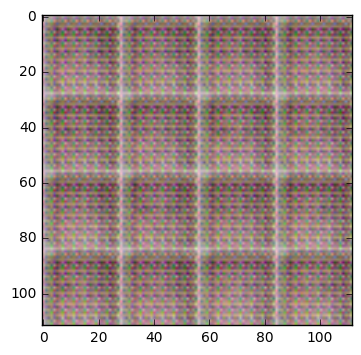

Epoch 0/1... Discriminator Loss: 0.4643... Generator Loss: 1.3150
Epoch 0/1... Discriminator Loss: 2.0321... Generator Loss: 0.1877
Epoch 0/1... Discriminator Loss: 2.4803... Generator Loss: 0.1248
Epoch 0/1... Discriminator Loss: 0.7976... Generator Loss: 6.3120
Epoch 0/1... Discriminator Loss: 0.5241... Generator Loss: 1.1945


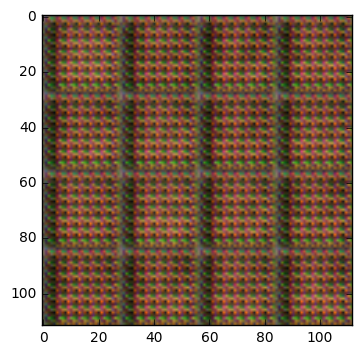

Epoch 0/1... Discriminator Loss: 0.4293... Generator Loss: 4.8375
Epoch 0/1... Discriminator Loss: 0.9522... Generator Loss: 0.8681
Epoch 0/1... Discriminator Loss: 1.5284... Generator Loss: 3.2267
Epoch 0/1... Discriminator Loss: 0.5745... Generator Loss: 1.4308
Epoch 0/1... Discriminator Loss: 0.7235... Generator Loss: 0.9550


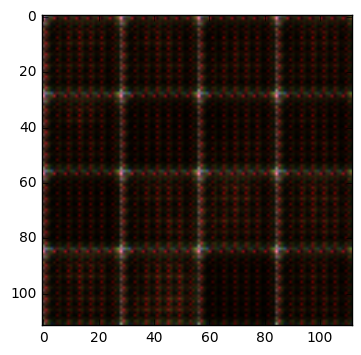

Epoch 0/1... Discriminator Loss: 0.8974... Generator Loss: 0.7170
Epoch 0/1... Discriminator Loss: 1.0384... Generator Loss: 0.7979
Epoch 0/1... Discriminator Loss: 0.9071... Generator Loss: 0.8049
Epoch 0/1... Discriminator Loss: 0.9164... Generator Loss: 1.2938
Epoch 0/1... Discriminator Loss: 0.6906... Generator Loss: 1.4914


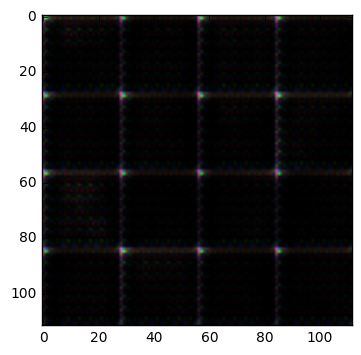

Epoch 0/1... Discriminator Loss: 0.8960... Generator Loss: 0.7728
Epoch 0/1... Discriminator Loss: 1.2366... Generator Loss: 0.7100
Epoch 0/1... Discriminator Loss: 0.9661... Generator Loss: 1.6893
Epoch 0/1... Discriminator Loss: 0.8785... Generator Loss: 1.3304
Epoch 0/1... Discriminator Loss: 1.3458... Generator Loss: 0.4566


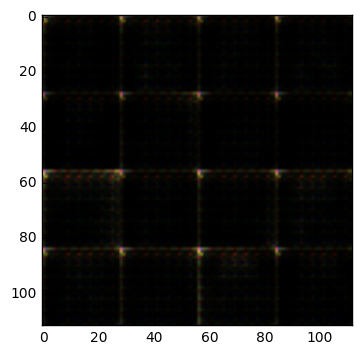

Epoch 0/1... Discriminator Loss: 1.3640... Generator Loss: 1.2636
Epoch 0/1... Discriminator Loss: 1.6859... Generator Loss: 0.3246
Epoch 0/1... Discriminator Loss: 1.1901... Generator Loss: 0.7665
Epoch 0/1... Discriminator Loss: 1.3846... Generator Loss: 0.7497
Epoch 0/1... Discriminator Loss: 1.4394... Generator Loss: 0.4277


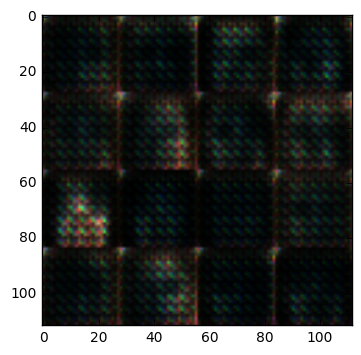

Epoch 0/1... Discriminator Loss: 1.4743... Generator Loss: 0.5347
Epoch 0/1... Discriminator Loss: 1.3707... Generator Loss: 1.0539
Epoch 0/1... Discriminator Loss: 1.5628... Generator Loss: 2.0342
Epoch 0/1... Discriminator Loss: 1.6445... Generator Loss: 0.5240
Epoch 0/1... Discriminator Loss: 1.5639... Generator Loss: 0.8355


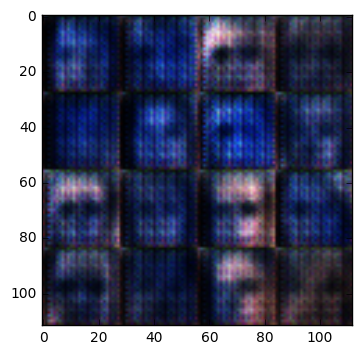

Epoch 0/1... Discriminator Loss: 1.4044... Generator Loss: 1.5524
Epoch 0/1... Discriminator Loss: 1.1337... Generator Loss: 1.1339
Epoch 0/1... Discriminator Loss: 1.0298... Generator Loss: 0.8232
Epoch 0/1... Discriminator Loss: 0.9511... Generator Loss: 1.0218
Epoch 0/1... Discriminator Loss: 1.0999... Generator Loss: 0.7760


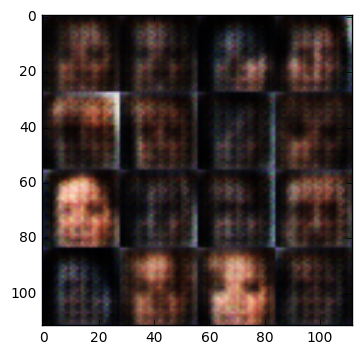

Epoch 0/1... Discriminator Loss: 1.3485... Generator Loss: 0.5696
Epoch 0/1... Discriminator Loss: 1.0576... Generator Loss: 1.1773
Epoch 0/1... Discriminator Loss: 1.7305... Generator Loss: 0.3369
Epoch 0/1... Discriminator Loss: 1.4169... Generator Loss: 0.4238
Epoch 0/1... Discriminator Loss: 1.0799... Generator Loss: 0.6907


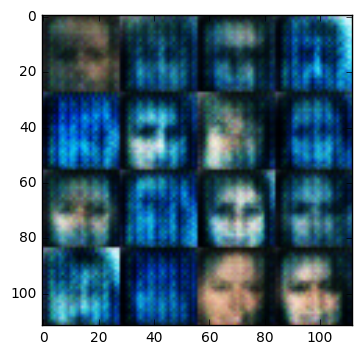

Epoch 0/1... Discriminator Loss: 1.2528... Generator Loss: 0.6010
Epoch 0/1... Discriminator Loss: 1.3465... Generator Loss: 0.6283
Epoch 0/1... Discriminator Loss: 1.3507... Generator Loss: 0.6878
Epoch 0/1... Discriminator Loss: 1.2523... Generator Loss: 0.6442
Epoch 0/1... Discriminator Loss: 1.1906... Generator Loss: 0.7180


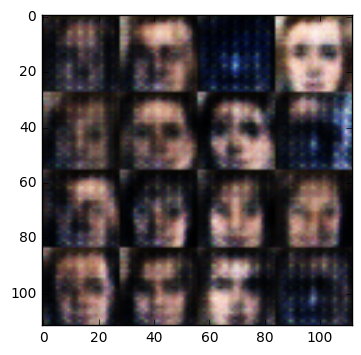

Epoch 0/1... Discriminator Loss: 1.1030... Generator Loss: 0.7523
Epoch 0/1... Discriminator Loss: 0.8177... Generator Loss: 1.2062
Epoch 0/1... Discriminator Loss: 1.4968... Generator Loss: 0.3841
Epoch 0/1... Discriminator Loss: 0.9384... Generator Loss: 0.9947
Epoch 0/1... Discriminator Loss: 1.4910... Generator Loss: 1.1558


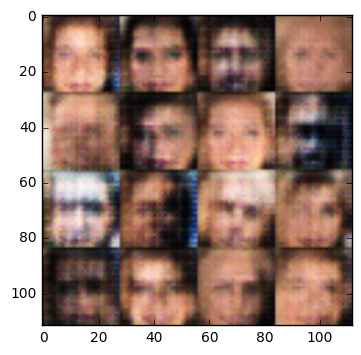

Epoch 0/1... Discriminator Loss: 1.2088... Generator Loss: 0.6741
Epoch 0/1... Discriminator Loss: 1.2203... Generator Loss: 0.6327
Epoch 0/1... Discriminator Loss: 1.2503... Generator Loss: 0.7704
Epoch 0/1... Discriminator Loss: 0.9526... Generator Loss: 1.1424
Epoch 0/1... Discriminator Loss: 1.1852... Generator Loss: 0.7931


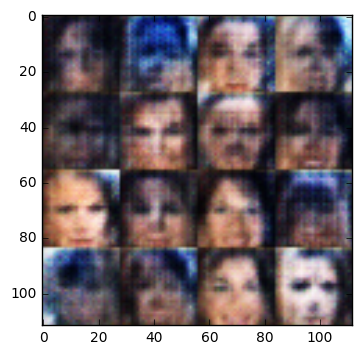

Epoch 0/1... Discriminator Loss: 1.1659... Generator Loss: 0.8429
Epoch 0/1... Discriminator Loss: 1.4964... Generator Loss: 0.9329
Epoch 0/1... Discriminator Loss: 1.3155... Generator Loss: 0.8193
Epoch 0/1... Discriminator Loss: 1.2800... Generator Loss: 0.6460
Epoch 0/1... Discriminator Loss: 1.5477... Generator Loss: 0.4124


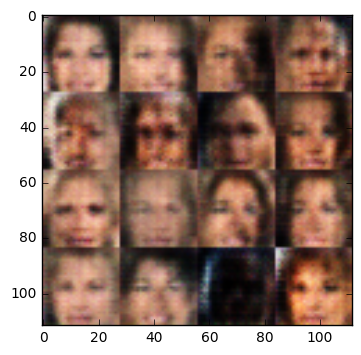

Epoch 0/1... Discriminator Loss: 1.3473... Generator Loss: 0.6949
Epoch 0/1... Discriminator Loss: 1.0070... Generator Loss: 0.9751
Epoch 0/1... Discriminator Loss: 1.3860... Generator Loss: 0.4894
Epoch 0/1... Discriminator Loss: 1.2240... Generator Loss: 0.7360
Epoch 0/1... Discriminator Loss: 1.2697... Generator Loss: 0.7338


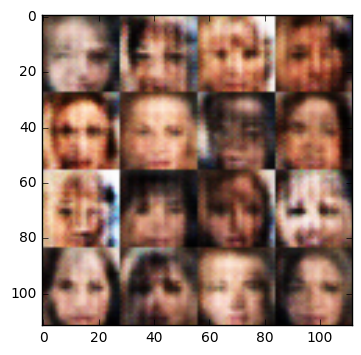

Epoch 0/1... Discriminator Loss: 1.1471... Generator Loss: 0.8167
Epoch 0/1... Discriminator Loss: 1.2939... Generator Loss: 0.8541
Epoch 0/1... Discriminator Loss: 1.1974... Generator Loss: 0.7530
Epoch 0/1... Discriminator Loss: 1.2019... Generator Loss: 0.8602
Epoch 0/1... Discriminator Loss: 1.1598... Generator Loss: 0.6976


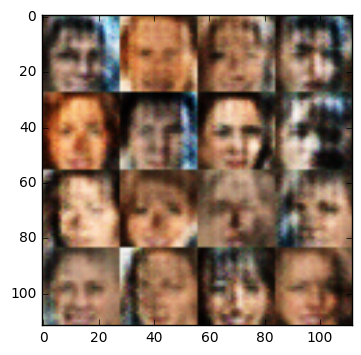

Epoch 0/1... Discriminator Loss: 1.2787... Generator Loss: 0.7481
Epoch 0/1... Discriminator Loss: 1.1492... Generator Loss: 0.7525
Epoch 0/1... Discriminator Loss: 1.2401... Generator Loss: 0.6104
Epoch 0/1... Discriminator Loss: 1.2255... Generator Loss: 0.7243
Epoch 0/1... Discriminator Loss: 1.2092... Generator Loss: 0.7201


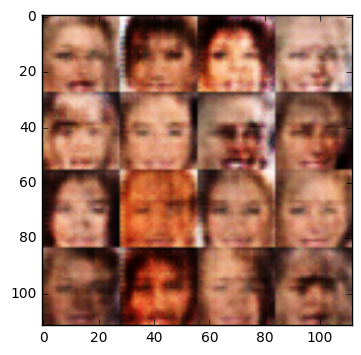

Epoch 0/1... Discriminator Loss: 1.0068... Generator Loss: 1.0446
Epoch 0/1... Discriminator Loss: 1.3219... Generator Loss: 0.5427
Epoch 0/1... Discriminator Loss: 1.4418... Generator Loss: 0.4962
Epoch 0/1... Discriminator Loss: 1.2004... Generator Loss: 1.1982
Epoch 0/1... Discriminator Loss: 1.6862... Generator Loss: 0.4201


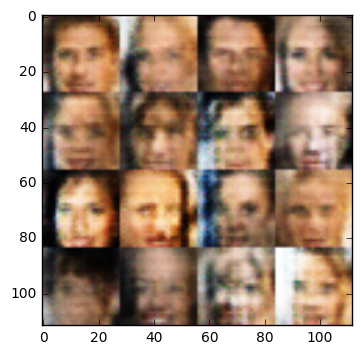

Epoch 0/1... Discriminator Loss: 1.5278... Generator Loss: 0.5114
Epoch 0/1... Discriminator Loss: 1.3025... Generator Loss: 0.5988
Epoch 0/1... Discriminator Loss: 1.4942... Generator Loss: 0.5158
Epoch 0/1... Discriminator Loss: 1.1132... Generator Loss: 0.7497
Epoch 0/1... Discriminator Loss: 1.2760... Generator Loss: 0.6651


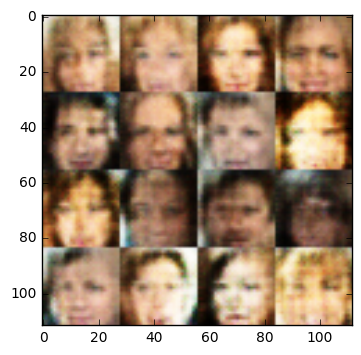

Epoch 0/1... Discriminator Loss: 1.1990... Generator Loss: 0.8578
Epoch 0/1... Discriminator Loss: 1.2679... Generator Loss: 0.5623
Epoch 0/1... Discriminator Loss: 1.2982... Generator Loss: 0.6439
Epoch 0/1... Discriminator Loss: 1.2280... Generator Loss: 0.7388
Epoch 0/1... Discriminator Loss: 1.2266... Generator Loss: 0.8335


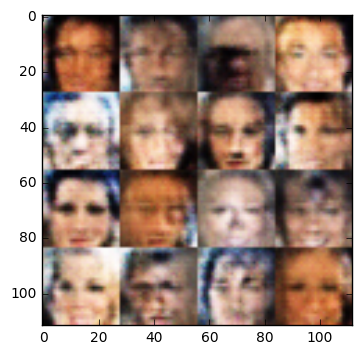

Epoch 0/1... Discriminator Loss: 1.3876... Generator Loss: 0.5672
Epoch 0/1... Discriminator Loss: 1.3707... Generator Loss: 0.6314
Epoch 0/1... Discriminator Loss: 1.5221... Generator Loss: 0.5063
Epoch 0/1... Discriminator Loss: 1.3634... Generator Loss: 0.6017
Epoch 0/1... Discriminator Loss: 1.2010... Generator Loss: 0.6427


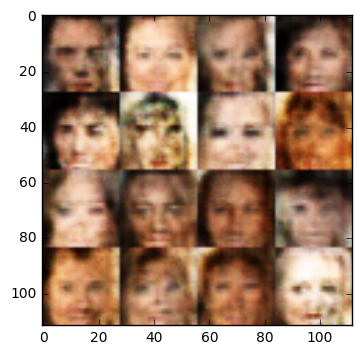

Epoch 0/1... Discriminator Loss: 1.3603... Generator Loss: 0.6504
Epoch 0/1... Discriminator Loss: 1.4945... Generator Loss: 0.5817
Epoch 0/1... Discriminator Loss: 1.4586... Generator Loss: 0.5988
Epoch 0/1... Discriminator Loss: 1.3830... Generator Loss: 0.6318
Epoch 0/1... Discriminator Loss: 1.3137... Generator Loss: 0.8893


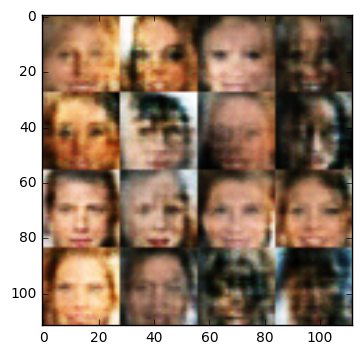

Epoch 0/1... Discriminator Loss: 1.7441... Generator Loss: 0.4871
Epoch 0/1... Discriminator Loss: 1.2133... Generator Loss: 0.8964
Epoch 0/1... Discriminator Loss: 1.1776... Generator Loss: 0.9974
Epoch 0/1... Discriminator Loss: 1.5198... Generator Loss: 0.4603
Epoch 0/1... Discriminator Loss: 1.3196... Generator Loss: 0.6055


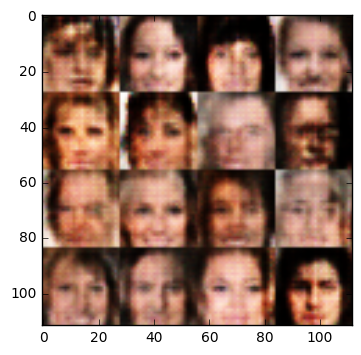

Epoch 0/1... Discriminator Loss: 1.2355... Generator Loss: 1.1374
Epoch 0/1... Discriminator Loss: 1.2430... Generator Loss: 0.7260
Epoch 0/1... Discriminator Loss: 1.1159... Generator Loss: 0.7356
Epoch 0/1... Discriminator Loss: 0.8860... Generator Loss: 1.2656
Epoch 0/1... Discriminator Loss: 1.2420... Generator Loss: 0.5473


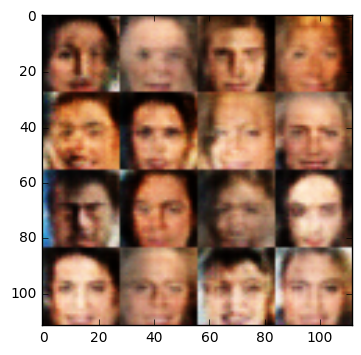

Epoch 0/1... Discriminator Loss: 1.2396... Generator Loss: 0.7325
Epoch 0/1... Discriminator Loss: 1.0676... Generator Loss: 0.8765
Epoch 0/1... Discriminator Loss: 1.1382... Generator Loss: 0.9408
Epoch 0/1... Discriminator Loss: 1.8285... Generator Loss: 0.4516
Epoch 0/1... Discriminator Loss: 1.3508... Generator Loss: 1.1736


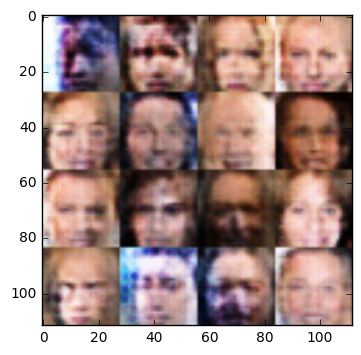

Epoch 0/1... Discriminator Loss: 1.0691... Generator Loss: 0.8332
Epoch 0/1... Discriminator Loss: 1.2208... Generator Loss: 0.6876
Epoch 0/1... Discriminator Loss: 1.2784... Generator Loss: 0.6781
Epoch 0/1... Discriminator Loss: 1.4407... Generator Loss: 0.4956
Epoch 0/1... Discriminator Loss: 1.1378... Generator Loss: 1.0251


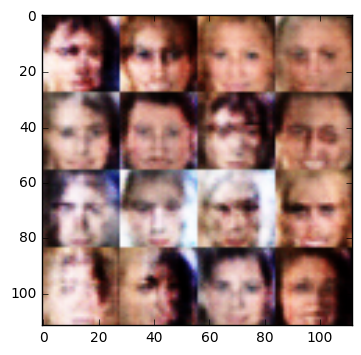

Epoch 0/1... Discriminator Loss: 1.3710... Generator Loss: 0.4824
Epoch 0/1... Discriminator Loss: 1.3102... Generator Loss: 0.5980
Epoch 0/1... Discriminator Loss: 1.3327... Generator Loss: 0.5713
Epoch 0/1... Discriminator Loss: 1.7730... Generator Loss: 0.3739
Epoch 0/1... Discriminator Loss: 1.2018... Generator Loss: 0.8287


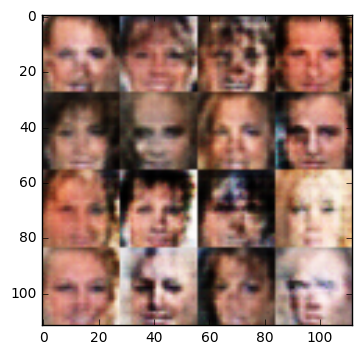

Epoch 0/1... Discriminator Loss: 1.3612... Generator Loss: 0.4456
Epoch 0/1... Discriminator Loss: 1.1887... Generator Loss: 0.6776
Epoch 0/1... Discriminator Loss: 0.9615... Generator Loss: 0.9308
Epoch 0/1... Discriminator Loss: 1.4887... Generator Loss: 0.4212
Epoch 0/1... Discriminator Loss: 1.4246... Generator Loss: 0.8040


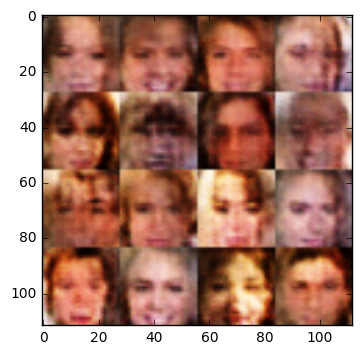

Epoch 0/1... Discriminator Loss: 1.0579... Generator Loss: 0.9754
Epoch 0/1... Discriminator Loss: 1.2240... Generator Loss: 0.6623
Epoch 0/1... Discriminator Loss: 1.1858... Generator Loss: 0.7226
Epoch 0/1... Discriminator Loss: 1.1132... Generator Loss: 0.7972
Epoch 0/1... Discriminator Loss: 1.0895... Generator Loss: 1.0151


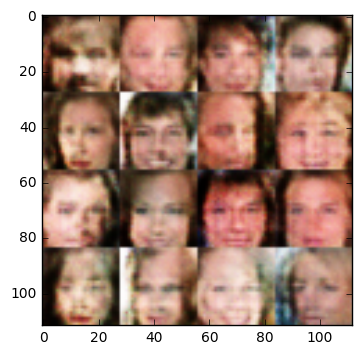

Epoch 0/1... Discriminator Loss: 1.0227... Generator Loss: 0.8403
Epoch 0/1... Discriminator Loss: 0.9137... Generator Loss: 1.1157
Epoch 0/1... Discriminator Loss: 1.4182... Generator Loss: 0.8324
Epoch 0/1... Discriminator Loss: 0.9242... Generator Loss: 1.1098
Epoch 0/1... Discriminator Loss: 1.2092... Generator Loss: 0.7291


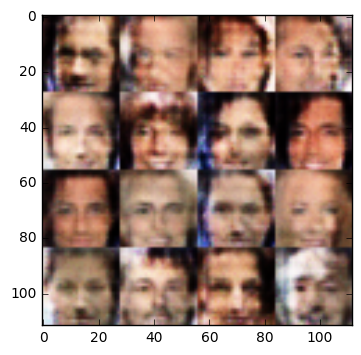

Epoch 0/1... Discriminator Loss: 1.2372... Generator Loss: 0.8519
Epoch 0/1... Discriminator Loss: 1.5282... Generator Loss: 0.6467
Epoch 0/1... Discriminator Loss: 1.2812... Generator Loss: 0.7338
Epoch 0/1... Discriminator Loss: 1.7340... Generator Loss: 0.4654
Epoch 0/1... Discriminator Loss: 1.1865... Generator Loss: 0.6734


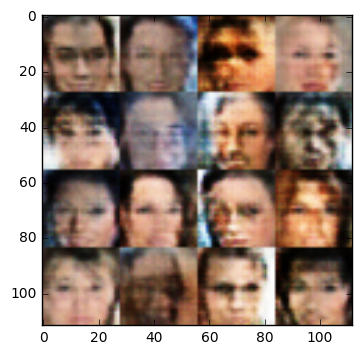

Epoch 0/1... Discriminator Loss: 1.1788... Generator Loss: 0.6497
Epoch 0/1... Discriminator Loss: 1.4310... Generator Loss: 0.5009
Epoch 0/1... Discriminator Loss: 1.1242... Generator Loss: 0.6781
Epoch 0/1... Discriminator Loss: 1.1655... Generator Loss: 0.7819
Epoch 0/1... Discriminator Loss: 1.4346... Generator Loss: 0.5853


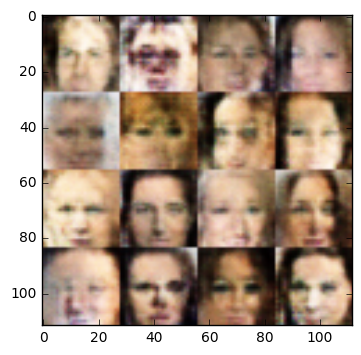

Epoch 0/1... Discriminator Loss: 1.1320... Generator Loss: 0.6764
Epoch 0/1... Discriminator Loss: 1.1952... Generator Loss: 0.7156
Epoch 0/1... Discriminator Loss: 1.4251... Generator Loss: 0.4018
Epoch 0/1... Discriminator Loss: 1.3155... Generator Loss: 0.6364
Epoch 0/1... Discriminator Loss: 1.1496... Generator Loss: 0.7411


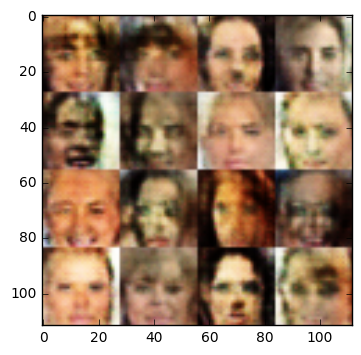

Epoch 0/1... Discriminator Loss: 1.2160... Generator Loss: 0.6299
Epoch 0/1... Discriminator Loss: 1.3332... Generator Loss: 0.7445
Epoch 0/1... Discriminator Loss: 0.9631... Generator Loss: 0.9766
Epoch 0/1... Discriminator Loss: 1.2716... Generator Loss: 0.6008
Epoch 0/1... Discriminator Loss: 0.9099... Generator Loss: 1.0696


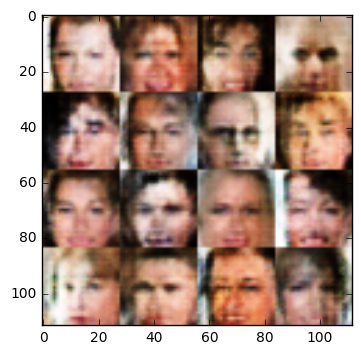

Epoch 0/1... Discriminator Loss: 1.4354... Generator Loss: 0.4705
Epoch 0/1... Discriminator Loss: 1.2670... Generator Loss: 0.5572
Epoch 0/1... Discriminator Loss: 1.5003... Generator Loss: 0.4927
Epoch 0/1... Discriminator Loss: 1.3572... Generator Loss: 0.5285
Epoch 0/1... Discriminator Loss: 1.3150... Generator Loss: 0.5855


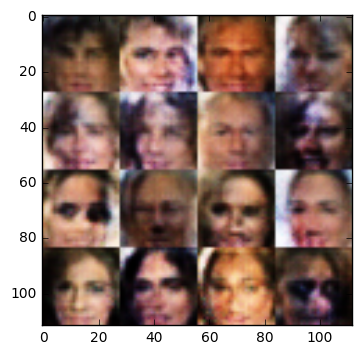

Epoch 0/1... Discriminator Loss: 1.0538... Generator Loss: 0.9301
Epoch 0/1... Discriminator Loss: 1.2955... Generator Loss: 0.5355
Epoch 0/1... Discriminator Loss: 1.2128... Generator Loss: 0.9349
Epoch 0/1... Discriminator Loss: 1.1148... Generator Loss: 0.7942
Epoch 0/1... Discriminator Loss: 1.0099... Generator Loss: 1.0305


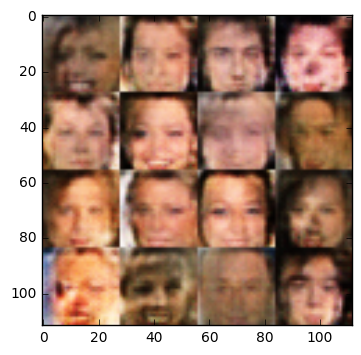

Epoch 0/1... Discriminator Loss: 1.3961... Generator Loss: 0.5805
Epoch 0/1... Discriminator Loss: 1.4221... Generator Loss: 0.6340
Epoch 0/1... Discriminator Loss: 1.3452... Generator Loss: 0.6735
Epoch 0/1... Discriminator Loss: 1.2356... Generator Loss: 0.6586
Epoch 0/1... Discriminator Loss: 1.1537... Generator Loss: 0.8460


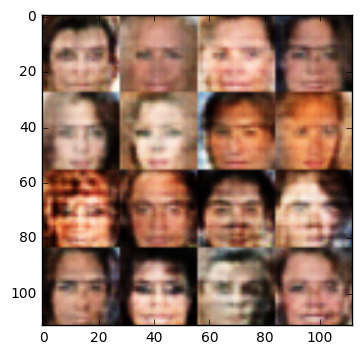

Epoch 0/1... Discriminator Loss: 1.2981... Generator Loss: 0.5893
Epoch 0/1... Discriminator Loss: 1.3443... Generator Loss: 0.5349
Epoch 0/1... Discriminator Loss: 1.1350... Generator Loss: 0.8392
Epoch 0/1... Discriminator Loss: 1.1861... Generator Loss: 0.8801
Epoch 0/1... Discriminator Loss: 1.2931... Generator Loss: 0.7913


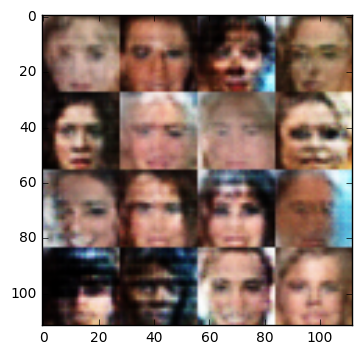

Epoch 0/1... Discriminator Loss: 1.3129... Generator Loss: 0.5854
Epoch 0/1... Discriminator Loss: 1.2989... Generator Loss: 0.5617
Epoch 0/1... Discriminator Loss: 1.1198... Generator Loss: 0.6320
Epoch 0/1... Discriminator Loss: 1.1852... Generator Loss: 0.6899
Epoch 0/1... Discriminator Loss: 1.2050... Generator Loss: 0.6437


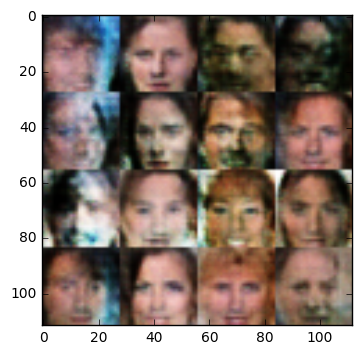

Epoch 0/1... Discriminator Loss: 1.2515... Generator Loss: 0.5255
Epoch 0/1... Discriminator Loss: 1.2895... Generator Loss: 0.5453
Epoch 0/1... Discriminator Loss: 1.1181... Generator Loss: 0.9571
Epoch 0/1... Discriminator Loss: 1.1640... Generator Loss: 0.6626
Epoch 0/1... Discriminator Loss: 1.2307... Generator Loss: 0.5514


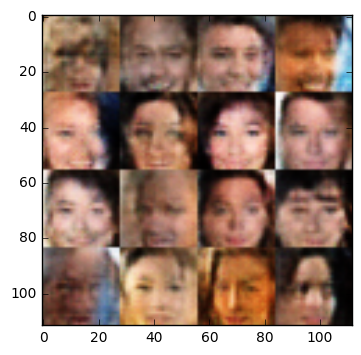

Epoch 0/1... Discriminator Loss: 1.3693... Generator Loss: 0.6130
Epoch 0/1... Discriminator Loss: 1.2666... Generator Loss: 0.7383
Epoch 0/1... Discriminator Loss: 1.4984... Generator Loss: 0.4460
Epoch 0/1... Discriminator Loss: 1.5359... Generator Loss: 0.4610
Epoch 0/1... Discriminator Loss: 1.3459... Generator Loss: 0.6565


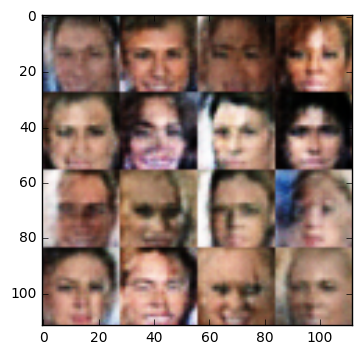

Epoch 0/1... Discriminator Loss: 1.0432... Generator Loss: 0.9029
Epoch 0/1... Discriminator Loss: 0.8712... Generator Loss: 1.1293
Epoch 0/1... Discriminator Loss: 1.1462... Generator Loss: 0.7077
Epoch 0/1... Discriminator Loss: 1.1110... Generator Loss: 0.8962
Epoch 0/1... Discriminator Loss: 1.1880... Generator Loss: 0.7518


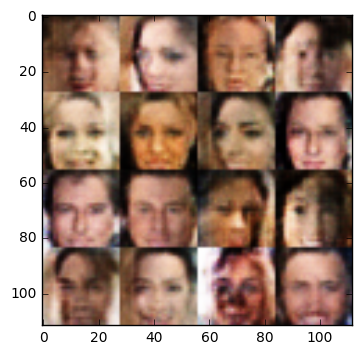

Epoch 0/1... Discriminator Loss: 1.3935... Generator Loss: 0.4779
Epoch 0/1... Discriminator Loss: 1.6868... Generator Loss: 0.4254
Epoch 0/1... Discriminator Loss: 1.0894... Generator Loss: 0.7754
Epoch 0/1... Discriminator Loss: 1.0261... Generator Loss: 0.9450
Epoch 0/1... Discriminator Loss: 1.1515... Generator Loss: 0.7064


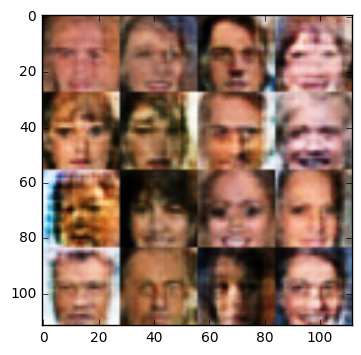

Epoch 0/1... Discriminator Loss: 1.3326... Generator Loss: 0.5367
Epoch 0/1... Discriminator Loss: 1.2463... Generator Loss: 1.0463
Epoch 0/1... Discriminator Loss: 1.0822... Generator Loss: 0.8618
Epoch 0/1... Discriminator Loss: 1.0695... Generator Loss: 0.6901
Epoch 0/1... Discriminator Loss: 1.1988... Generator Loss: 0.6029


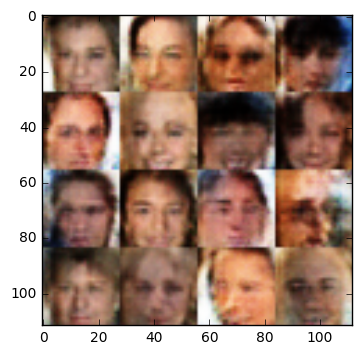

Epoch 0/1... Discriminator Loss: 1.1286... Generator Loss: 0.6415
Epoch 0/1... Discriminator Loss: 1.1773... Generator Loss: 1.4214
Epoch 0/1... Discriminator Loss: 1.2917... Generator Loss: 0.6229
Epoch 0/1... Discriminator Loss: 1.2750... Generator Loss: 0.7177
Epoch 0/1... Discriminator Loss: 1.1659... Generator Loss: 0.6629


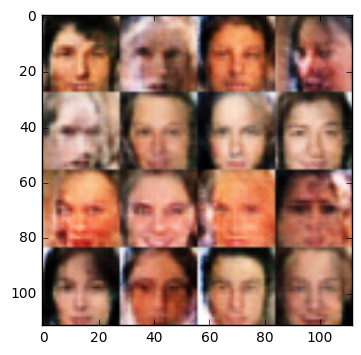

Epoch 0/1... Discriminator Loss: 1.2228... Generator Loss: 0.7127
Epoch 0/1... Discriminator Loss: 1.2502... Generator Loss: 0.5787
Epoch 0/1... Discriminator Loss: 1.2854... Generator Loss: 0.7378
Epoch 0/1... Discriminator Loss: 1.2430... Generator Loss: 0.7734
Epoch 0/1... Discriminator Loss: 1.2606... Generator Loss: 0.5935


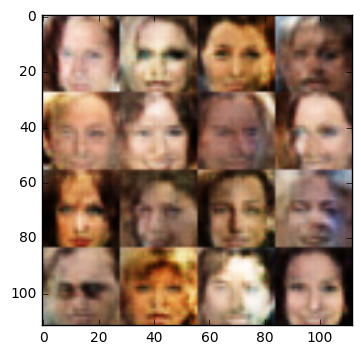

Epoch 0/1... Discriminator Loss: 0.9947... Generator Loss: 0.8544
Epoch 0/1... Discriminator Loss: 1.0044... Generator Loss: 1.0787
Epoch 0/1... Discriminator Loss: 1.2085... Generator Loss: 0.6149
Epoch 0/1... Discriminator Loss: 1.0931... Generator Loss: 0.8123
Epoch 0/1... Discriminator Loss: 1.5884... Generator Loss: 0.3825


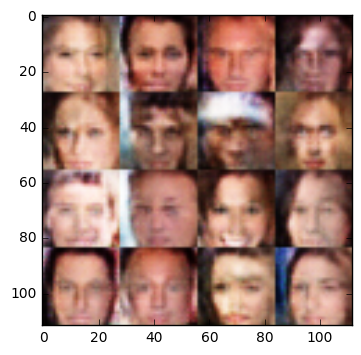

Epoch 0/1... Discriminator Loss: 1.4278... Generator Loss: 0.4524
Epoch 0/1... Discriminator Loss: 1.2132... Generator Loss: 0.6430
Epoch 0/1... Discriminator Loss: 1.3879... Generator Loss: 0.5323
Epoch 0/1... Discriminator Loss: 1.6702... Generator Loss: 0.3001
Epoch 0/1... Discriminator Loss: 1.0304... Generator Loss: 0.8080


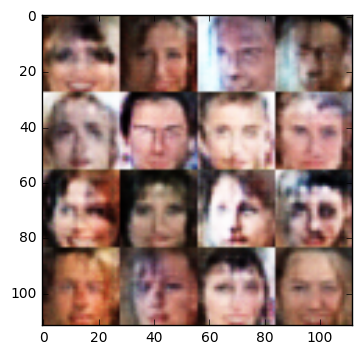

Epoch 0/1... Discriminator Loss: 1.2149... Generator Loss: 0.7016
Epoch 0/1... Discriminator Loss: 1.2845... Generator Loss: 0.7167
Epoch 0/1... Discriminator Loss: 0.9460... Generator Loss: 1.1039
Epoch 0/1... Discriminator Loss: 1.4815... Generator Loss: 0.4295
Epoch 0/1... Discriminator Loss: 1.3227... Generator Loss: 0.7357


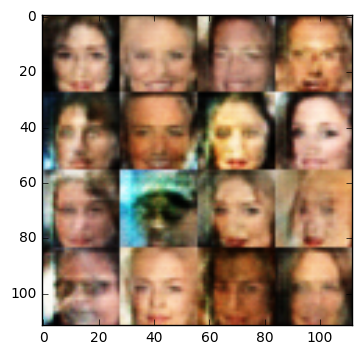

Epoch 0/1... Discriminator Loss: 1.3854... Generator Loss: 0.5162
Epoch 0/1... Discriminator Loss: 1.4017... Generator Loss: 0.5328
Epoch 0/1... Discriminator Loss: 1.1503... Generator Loss: 0.7864
Epoch 0/1... Discriminator Loss: 1.3671... Generator Loss: 0.4528
Epoch 0/1... Discriminator Loss: 0.8207... Generator Loss: 0.9355


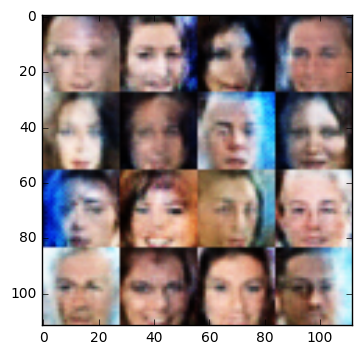

Epoch 0/1... Discriminator Loss: 0.9862... Generator Loss: 0.8910
Epoch 0/1... Discriminator Loss: 1.2052... Generator Loss: 0.6042
Epoch 0/1... Discriminator Loss: 0.9681... Generator Loss: 0.8376
Epoch 0/1... Discriminator Loss: 1.1492... Generator Loss: 0.6469
Epoch 0/1... Discriminator Loss: 1.1282... Generator Loss: 0.7673


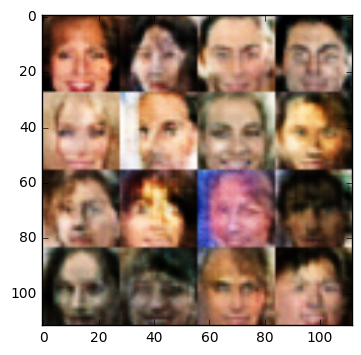

Epoch 0/1... Discriminator Loss: 1.4579... Generator Loss: 0.5477
Epoch 0/1... Discriminator Loss: 1.0895... Generator Loss: 0.6980
Epoch 0/1... Discriminator Loss: 1.2405... Generator Loss: 0.5958
Epoch 0/1... Discriminator Loss: 1.4669... Generator Loss: 0.4164
Epoch 0/1... Discriminator Loss: 1.0486... Generator Loss: 0.6848


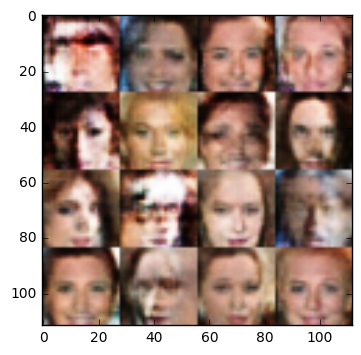

Epoch 0/1... Discriminator Loss: 1.5416... Generator Loss: 0.4626
Epoch 0/1... Discriminator Loss: 1.2221... Generator Loss: 0.5810
Epoch 0/1... Discriminator Loss: 1.2512... Generator Loss: 0.6715
Epoch 0/1... Discriminator Loss: 1.7952... Generator Loss: 0.3670
Epoch 0/1... Discriminator Loss: 1.3923... Generator Loss: 0.4891


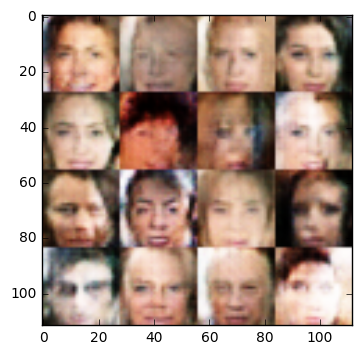

Epoch 0/1... Discriminator Loss: 1.4101... Generator Loss: 0.7559
Epoch 0/1... Discriminator Loss: 1.4435... Generator Loss: 0.4675
Epoch 0/1... Discriminator Loss: 1.5236... Generator Loss: 0.5019
Epoch 0/1... Discriminator Loss: 1.0438... Generator Loss: 1.0563
Epoch 0/1... Discriminator Loss: 1.3552... Generator Loss: 0.6069


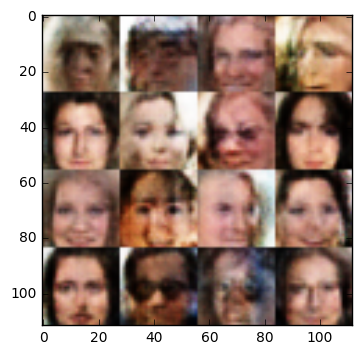

Epoch 0/1... Discriminator Loss: 1.0665... Generator Loss: 0.7490
Epoch 0/1... Discriminator Loss: 0.8569... Generator Loss: 0.9997
Epoch 0/1... Discriminator Loss: 1.1583... Generator Loss: 0.8309
Epoch 0/1... Discriminator Loss: 1.2684... Generator Loss: 0.7263
Epoch 0/1... Discriminator Loss: 0.9949... Generator Loss: 0.7954


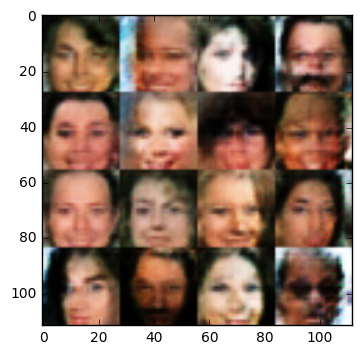

Epoch 0/1... Discriminator Loss: 1.2224... Generator Loss: 0.6966
Epoch 0/1... Discriminator Loss: 1.0585... Generator Loss: 0.7154
Epoch 0/1... Discriminator Loss: 1.2146... Generator Loss: 0.6451
Epoch 0/1... Discriminator Loss: 1.8310... Generator Loss: 0.4518
Epoch 0/1... Discriminator Loss: 1.0928... Generator Loss: 0.7411


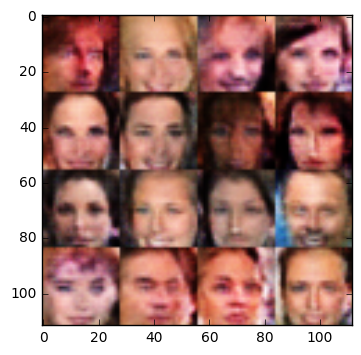

Epoch 0/1... Discriminator Loss: 1.0564... Generator Loss: 0.8856
Epoch 0/1... Discriminator Loss: 1.2048... Generator Loss: 0.5860
Epoch 0/1... Discriminator Loss: 1.0911... Generator Loss: 0.8317
Epoch 0/1... Discriminator Loss: 1.4935... Generator Loss: 0.4051
Epoch 0/1... Discriminator Loss: 1.3068... Generator Loss: 0.7029


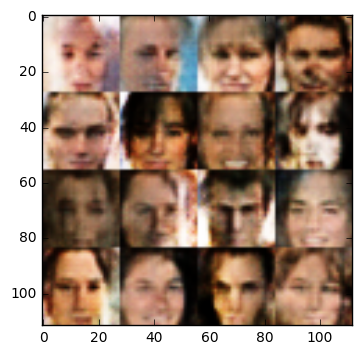

Epoch 0/1... Discriminator Loss: 1.4091... Generator Loss: 0.4705
Epoch 0/1... Discriminator Loss: 1.5091... Generator Loss: 0.3712
Epoch 0/1... Discriminator Loss: 1.4295... Generator Loss: 0.4755
Epoch 0/1... Discriminator Loss: 1.3683... Generator Loss: 0.6395
Epoch 0/1... Discriminator Loss: 1.0126... Generator Loss: 0.9340


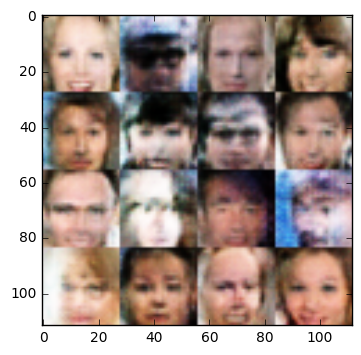

Epoch 0/1... Discriminator Loss: 1.2840... Generator Loss: 0.6601
Epoch 0/1... Discriminator Loss: 1.1095... Generator Loss: 0.9580
Epoch 0/1... Discriminator Loss: 1.0154... Generator Loss: 0.7781
Epoch 0/1... Discriminator Loss: 1.2083... Generator Loss: 0.5585
Epoch 0/1... Discriminator Loss: 1.3942... Generator Loss: 0.6674


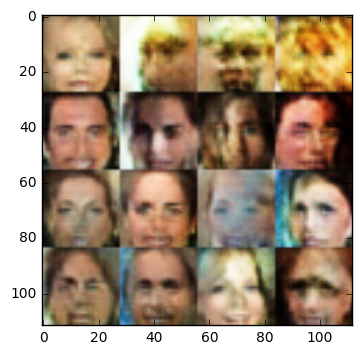

Epoch 0/1... Discriminator Loss: 1.1397... Generator Loss: 0.7308
Epoch 0/1... Discriminator Loss: 1.2114... Generator Loss: 0.5453
Epoch 0/1... Discriminator Loss: 1.2474... Generator Loss: 0.9048
Epoch 0/1... Discriminator Loss: 1.4197... Generator Loss: 0.4651
Epoch 0/1... Discriminator Loss: 1.1492... Generator Loss: 0.8070


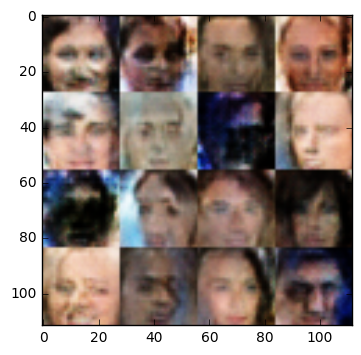

Epoch 0/1... Discriminator Loss: 1.1333... Generator Loss: 0.7856
Epoch 0/1... Discriminator Loss: 1.3303... Generator Loss: 0.5148
Epoch 0/1... Discriminator Loss: 1.0226... Generator Loss: 1.4407
Epoch 0/1... Discriminator Loss: 1.2813... Generator Loss: 0.5662
Epoch 0/1... Discriminator Loss: 1.4120... Generator Loss: 0.4847


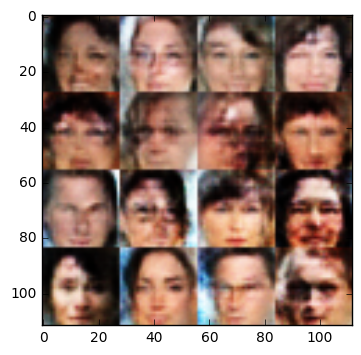

Epoch 0/1... Discriminator Loss: 1.0432... Generator Loss: 0.7416
Epoch 0/1... Discriminator Loss: 1.3796... Generator Loss: 0.4479
Epoch 0/1... Discriminator Loss: 1.2215... Generator Loss: 0.7978
Epoch 0/1... Discriminator Loss: 1.1771... Generator Loss: 0.6077
Epoch 0/1... Discriminator Loss: 1.2813... Generator Loss: 0.6236


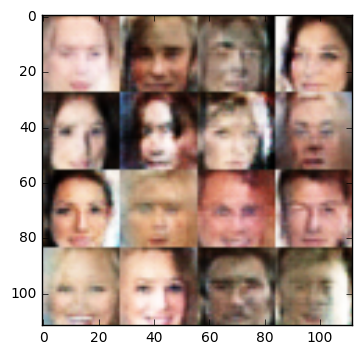

Epoch 0/1... Discriminator Loss: 1.0877... Generator Loss: 0.7987
Epoch 0/1... Discriminator Loss: 1.3933... Generator Loss: 0.4448
Epoch 0/1... Discriminator Loss: 1.3451... Generator Loss: 0.4996
Epoch 0/1... Discriminator Loss: 1.1893... Generator Loss: 0.6011
Epoch 0/1... Discriminator Loss: 1.2290... Generator Loss: 0.5839


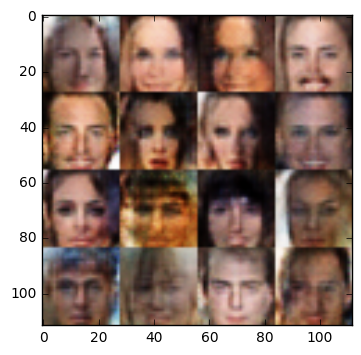

Epoch 0/1... Discriminator Loss: 1.2940... Generator Loss: 0.5370
Epoch 0/1... Discriminator Loss: 1.1413... Generator Loss: 0.6083
Epoch 0/1... Discriminator Loss: 1.2798... Generator Loss: 0.4901
Epoch 0/1... Discriminator Loss: 0.9151... Generator Loss: 1.2352
Epoch 0/1... Discriminator Loss: 1.2160... Generator Loss: 0.7326


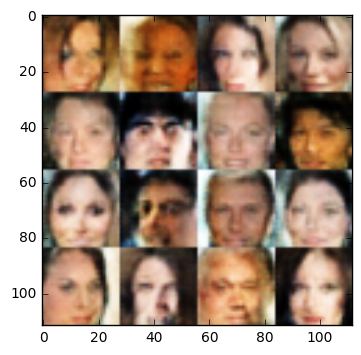

Epoch 0/1... Discriminator Loss: 1.0234... Generator Loss: 0.8686
Epoch 0/1... Discriminator Loss: 1.4139... Generator Loss: 0.4194
Epoch 0/1... Discriminator Loss: 0.9371... Generator Loss: 0.9965
Epoch 0/1... Discriminator Loss: 1.0912... Generator Loss: 0.6681
Epoch 0/1... Discriminator Loss: 1.2254... Generator Loss: 0.5957


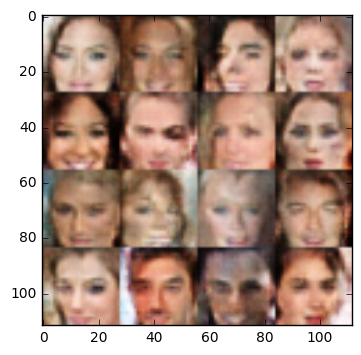

Epoch 0/1... Discriminator Loss: 1.2338... Generator Loss: 0.6743
Epoch 0/1... Discriminator Loss: 1.5815... Generator Loss: 0.4383
Epoch 0/1... Discriminator Loss: 1.2313... Generator Loss: 0.6415
Epoch 0/1... Discriminator Loss: 1.5253... Generator Loss: 0.3832
Epoch 0/1... Discriminator Loss: 1.3260... Generator Loss: 0.5087


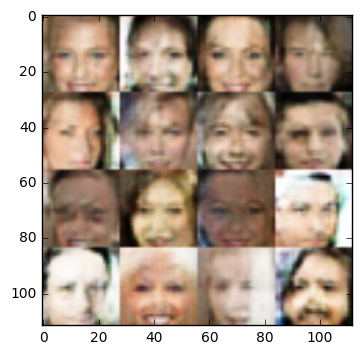

Epoch 0/1... Discriminator Loss: 1.1051... Generator Loss: 0.8270
Epoch 0/1... Discriminator Loss: 1.3740... Generator Loss: 0.6666
Epoch 0/1... Discriminator Loss: 1.1547... Generator Loss: 0.8284
Epoch 0/1... Discriminator Loss: 1.3223... Generator Loss: 0.5410
Epoch 0/1... Discriminator Loss: 1.3411... Generator Loss: 0.4369


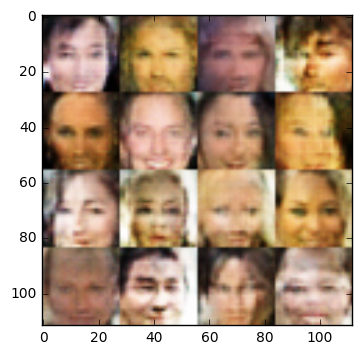

Epoch 0/1... Discriminator Loss: 1.3488... Generator Loss: 0.4896
Epoch 0/1... Discriminator Loss: 1.5183... Generator Loss: 0.3676
Epoch 0/1... Discriminator Loss: 1.2168... Generator Loss: 0.5769
Epoch 0/1... Discriminator Loss: 1.4068... Generator Loss: 0.5711
Epoch 0/1... Discriminator Loss: 1.1403... Generator Loss: 0.6523


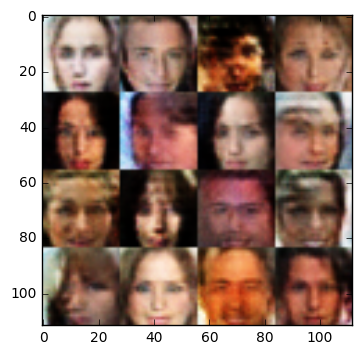

Epoch 0/1... Discriminator Loss: 1.0645... Generator Loss: 1.0009
Epoch 0/1... Discriminator Loss: 1.4159... Generator Loss: 0.4690
Epoch 0/1... Discriminator Loss: 0.7404... Generator Loss: 1.1521
Epoch 0/1... Discriminator Loss: 1.1218... Generator Loss: 0.6770
Epoch 0/1... Discriminator Loss: 1.2674... Generator Loss: 0.5370


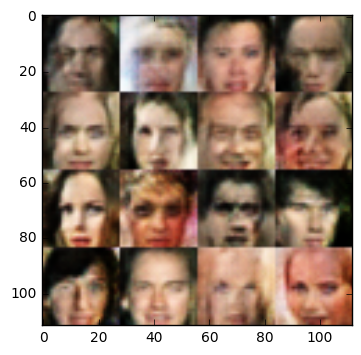

Epoch 0/1... Discriminator Loss: 0.9938... Generator Loss: 0.9919
Epoch 0/1... Discriminator Loss: 1.1540... Generator Loss: 0.7255
Epoch 0/1... Discriminator Loss: 1.0630... Generator Loss: 0.8221
Epoch 0/1... Discriminator Loss: 0.7333... Generator Loss: 1.1272
Epoch 0/1... Discriminator Loss: 1.1479... Generator Loss: 0.6896


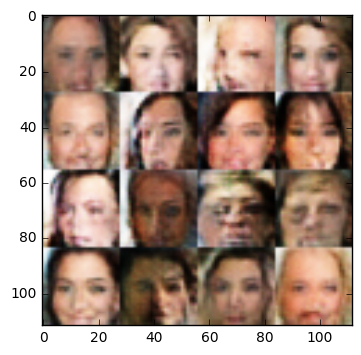

Epoch 0/1... Discriminator Loss: 1.2342... Generator Loss: 0.7317
Epoch 0/1... Discriminator Loss: 1.3705... Generator Loss: 0.5199
Epoch 0/1... Discriminator Loss: 1.1228... Generator Loss: 0.6130
Epoch 0/1... Discriminator Loss: 1.4378... Generator Loss: 0.4068
Epoch 0/1... Discriminator Loss: 1.2190... Generator Loss: 0.5775


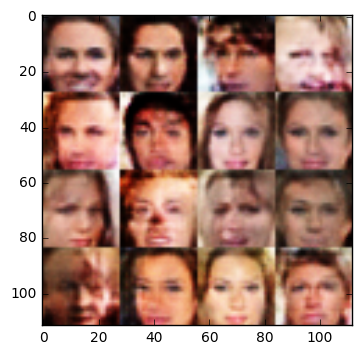

Epoch 0/1... Discriminator Loss: 1.5177... Generator Loss: 0.4057
Epoch 0/1... Discriminator Loss: 1.2862... Generator Loss: 0.5027
Epoch 0/1... Discriminator Loss: 1.3948... Generator Loss: 0.5386
Epoch 0/1... Discriminator Loss: 0.9359... Generator Loss: 0.8664
Epoch 0/1... Discriminator Loss: 0.9521... Generator Loss: 0.9438


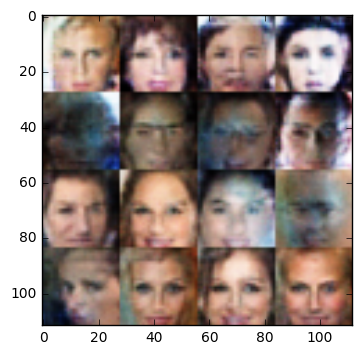

Epoch 0/1... Discriminator Loss: 1.5114... Generator Loss: 0.4422
Epoch 0/1... Discriminator Loss: 1.3725... Generator Loss: 0.5281
Epoch 0/1... Discriminator Loss: 1.5966... Generator Loss: 0.3184
Epoch 0/1... Discriminator Loss: 1.1701... Generator Loss: 0.6055
Epoch 0/1... Discriminator Loss: 1.2969... Generator Loss: 0.5174


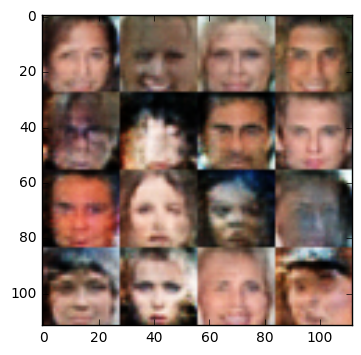

Epoch 0/1... Discriminator Loss: 1.0346... Generator Loss: 0.6846
Epoch 0/1... Discriminator Loss: 1.2057... Generator Loss: 0.7094
Epoch 0/1... Discriminator Loss: 1.0352... Generator Loss: 0.8104
Epoch 0/1... Discriminator Loss: 1.3122... Generator Loss: 0.6330
Epoch 0/1... Discriminator Loss: 1.1880... Generator Loss: 0.6788


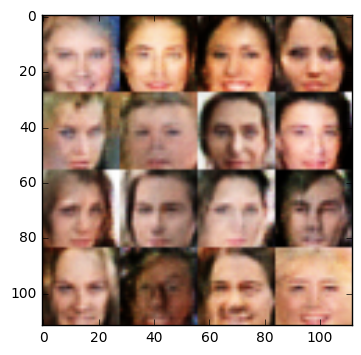

Epoch 0/1... Discriminator Loss: 1.1541... Generator Loss: 0.9273
Epoch 0/1... Discriminator Loss: 1.2982... Generator Loss: 0.7050
Epoch 0/1... Discriminator Loss: 1.0644... Generator Loss: 0.7303
Epoch 0/1... Discriminator Loss: 1.3392... Generator Loss: 0.5616
Epoch 0/1... Discriminator Loss: 1.2986... Generator Loss: 0.5951


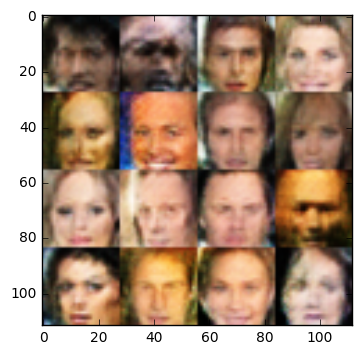

Epoch 0/1... Discriminator Loss: 1.2810... Generator Loss: 0.5441
Epoch 0/1... Discriminator Loss: 1.2678... Generator Loss: 0.8122
Epoch 0/1... Discriminator Loss: 1.3323... Generator Loss: 0.4634
Epoch 0/1... Discriminator Loss: 1.3455... Generator Loss: 0.5553
Epoch 0/1... Discriminator Loss: 1.1373... Generator Loss: 0.6853


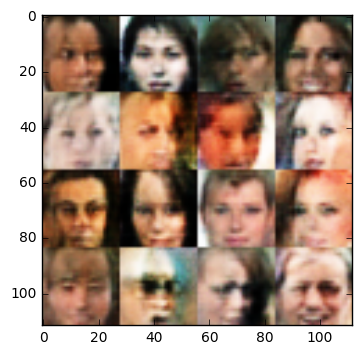

Epoch 0/1... Discriminator Loss: 1.0719... Generator Loss: 0.7417
Epoch 0/1... Discriminator Loss: 0.9965... Generator Loss: 0.8104
Epoch 0/1... Discriminator Loss: 1.2396... Generator Loss: 1.2131
Epoch 0/1... Discriminator Loss: 1.4001... Generator Loss: 0.5268
Epoch 0/1... Discriminator Loss: 1.3418... Generator Loss: 0.4318


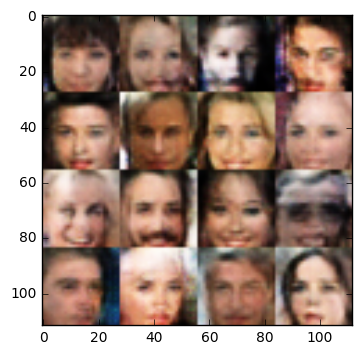

Epoch 0/1... Discriminator Loss: 1.5142... Generator Loss: 0.4101
Epoch 0/1... Discriminator Loss: 1.2309... Generator Loss: 0.6097
Epoch 0/1... Discriminator Loss: 1.2083... Generator Loss: 0.6111
Epoch 0/1... Discriminator Loss: 1.1873... Generator Loss: 0.5935
Epoch 0/1... Discriminator Loss: 1.0726... Generator Loss: 0.7240


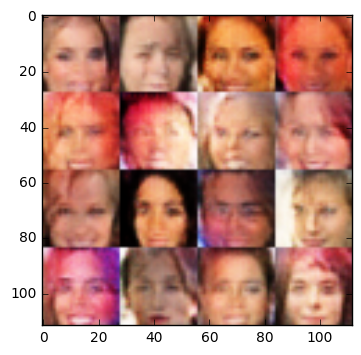

Epoch 0/1... Discriminator Loss: 1.2348... Generator Loss: 0.5229
Epoch 0/1... Discriminator Loss: 1.2092... Generator Loss: 0.8972
Epoch 0/1... Discriminator Loss: 1.6557... Generator Loss: 0.4033
Epoch 0/1... Discriminator Loss: 1.0916... Generator Loss: 0.7499
Epoch 0/1... Discriminator Loss: 1.3012... Generator Loss: 0.5550


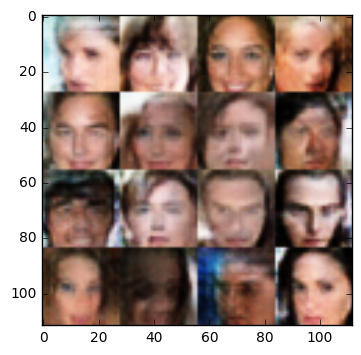

Epoch 0/1... Discriminator Loss: 1.4628... Generator Loss: 0.7156
Epoch 0/1... Discriminator Loss: 1.2869... Generator Loss: 0.5679
Epoch 0/1... Discriminator Loss: 1.6084... Generator Loss: 0.3358
Epoch 0/1... Discriminator Loss: 1.0509... Generator Loss: 0.8814
Epoch 0/1... Discriminator Loss: 1.1438... Generator Loss: 0.6712


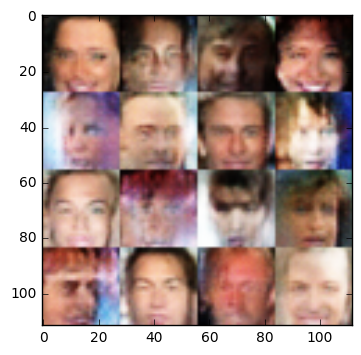

Epoch 0/1... Discriminator Loss: 0.9252... Generator Loss: 0.8635
Epoch 0/1... Discriminator Loss: 1.1972... Generator Loss: 0.6275
Epoch 0/1... Discriminator Loss: 0.8847... Generator Loss: 0.9066
Epoch 0/1... Discriminator Loss: 1.1606... Generator Loss: 0.5891
Epoch 0/1... Discriminator Loss: 1.1212... Generator Loss: 0.6334


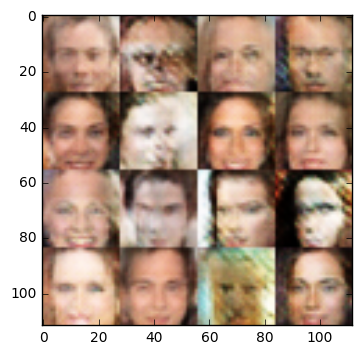

Epoch 0/1... Discriminator Loss: 0.9656... Generator Loss: 1.1547
Epoch 0/1... Discriminator Loss: 1.2662... Generator Loss: 0.5572
Epoch 0/1... Discriminator Loss: 1.2846... Generator Loss: 0.5636
Epoch 0/1... Discriminator Loss: 1.2868... Generator Loss: 0.7782
Epoch 0/1... Discriminator Loss: 1.5488... Generator Loss: 0.3709


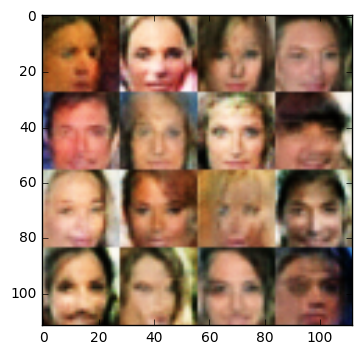

Epoch 0/1... Discriminator Loss: 1.2731... Generator Loss: 0.5665
Epoch 0/1... Discriminator Loss: 1.1080... Generator Loss: 0.6408
Epoch 0/1... Discriminator Loss: 1.1989... Generator Loss: 0.7760
Epoch 0/1... Discriminator Loss: 1.2345... Generator Loss: 0.5969
Epoch 0/1... Discriminator Loss: 1.1065... Generator Loss: 0.8266


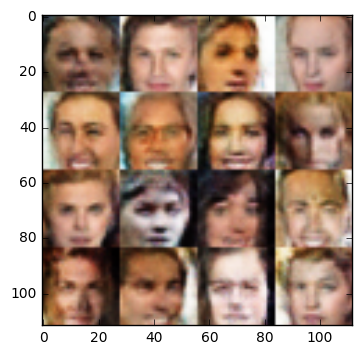

Epoch 0/1... Discriminator Loss: 1.4143... Generator Loss: 0.5635
Epoch 0/1... Discriminator Loss: 1.4153... Generator Loss: 0.6098
Epoch 0/1... Discriminator Loss: 1.4400... Generator Loss: 0.4529
Epoch 0/1... Discriminator Loss: 1.1631... Generator Loss: 0.7010
Epoch 0/1... Discriminator Loss: 1.1672... Generator Loss: 0.6038


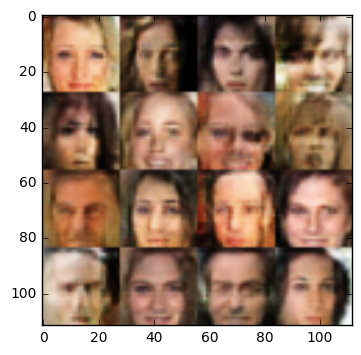

Epoch 0/1... Discriminator Loss: 1.4158... Generator Loss: 0.5398
Epoch 0/1... Discriminator Loss: 1.4430... Generator Loss: 0.3894
Epoch 0/1... Discriminator Loss: 1.3121... Generator Loss: 0.5622
Epoch 0/1... Discriminator Loss: 1.1259... Generator Loss: 0.7323
Epoch 0/1... Discriminator Loss: 1.5362... Generator Loss: 0.5644


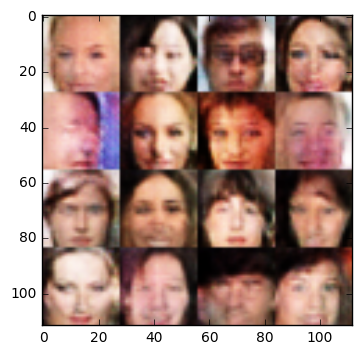

Epoch 0/1... Discriminator Loss: 1.4085... Generator Loss: 0.4830
Epoch 0/1... Discriminator Loss: 1.2009... Generator Loss: 0.7711
Epoch 0/1... Discriminator Loss: 1.0785... Generator Loss: 1.3236
Epoch 0/1... Discriminator Loss: 1.5935... Generator Loss: 0.4460
Epoch 0/1... Discriminator Loss: 1.3346... Generator Loss: 0.5648


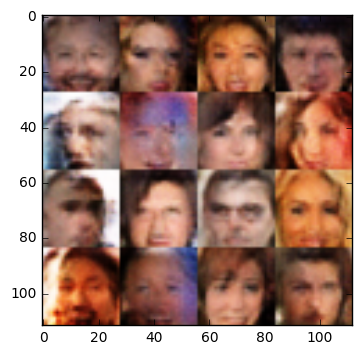

Epoch 0/1... Discriminator Loss: 1.0178... Generator Loss: 0.8062
Epoch 0/1... Discriminator Loss: 1.3836... Generator Loss: 0.4993
Epoch 0/1... Discriminator Loss: 1.2943... Generator Loss: 0.6038
Epoch 0/1... Discriminator Loss: 0.9571... Generator Loss: 0.9286
Epoch 0/1... Discriminator Loss: 1.1832... Generator Loss: 0.6380


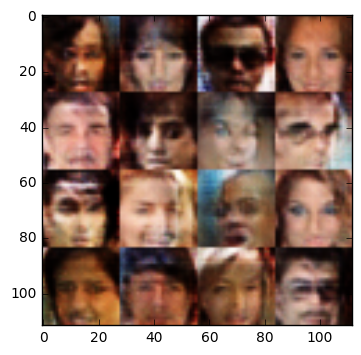

Epoch 0/1... Discriminator Loss: 1.1254... Generator Loss: 0.8085
Epoch 0/1... Discriminator Loss: 1.4345... Generator Loss: 0.4558
Epoch 0/1... Discriminator Loss: 1.3348... Generator Loss: 0.5192
Epoch 0/1... Discriminator Loss: 1.2525... Generator Loss: 0.6308
Epoch 0/1... Discriminator Loss: 1.2699... Generator Loss: 0.5102


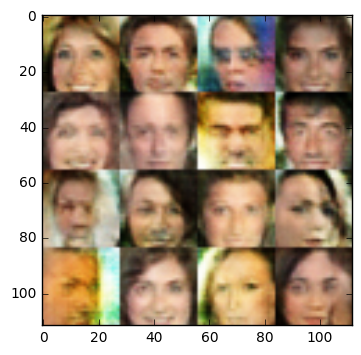

Epoch 0/1... Discriminator Loss: 1.2332... Generator Loss: 0.5162
Epoch 0/1... Discriminator Loss: 1.1332... Generator Loss: 0.7277
Epoch 0/1... Discriminator Loss: 1.0961... Generator Loss: 0.7885
Epoch 0/1... Discriminator Loss: 1.1689... Generator Loss: 0.9102
Epoch 0/1... Discriminator Loss: 1.2147... Generator Loss: 0.8484


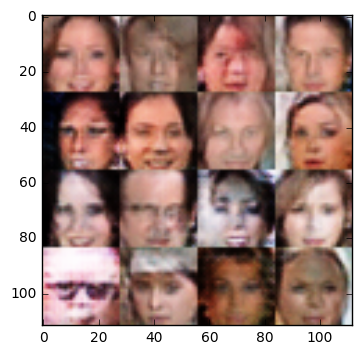

Epoch 0/1... Discriminator Loss: 1.0949... Generator Loss: 0.8770
Epoch 0/1... Discriminator Loss: 1.4765... Generator Loss: 0.4547
Epoch 0/1... Discriminator Loss: 1.2517... Generator Loss: 0.6057
Epoch 0/1... Discriminator Loss: 1.4705... Generator Loss: 0.4187
Epoch 0/1... Discriminator Loss: 0.9866... Generator Loss: 1.1340


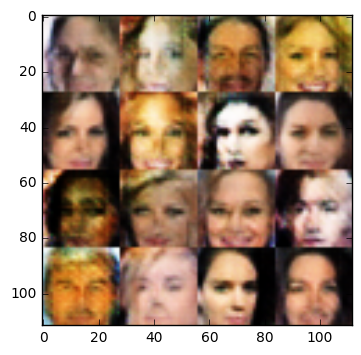

Epoch 0/1... Discriminator Loss: 1.1034... Generator Loss: 1.1470
Epoch 0/1... Discriminator Loss: 1.6067... Generator Loss: 0.3234
Epoch 0/1... Discriminator Loss: 1.2720... Generator Loss: 0.5792
Epoch 0/1... Discriminator Loss: 1.2573... Generator Loss: 0.5100
Epoch 0/1... Discriminator Loss: 1.3605... Generator Loss: 0.5553


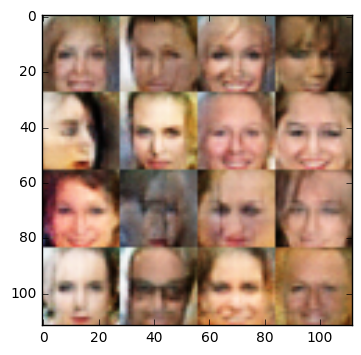

Epoch 0/1... Discriminator Loss: 1.2589... Generator Loss: 0.6312
Epoch 0/1... Discriminator Loss: 1.4649... Generator Loss: 0.4167
Epoch 0/1... Discriminator Loss: 1.2607... Generator Loss: 0.4538
Epoch 0/1... Discriminator Loss: 1.1720... Generator Loss: 0.6693
Epoch 0/1... Discriminator Loss: 1.2154... Generator Loss: 0.6900


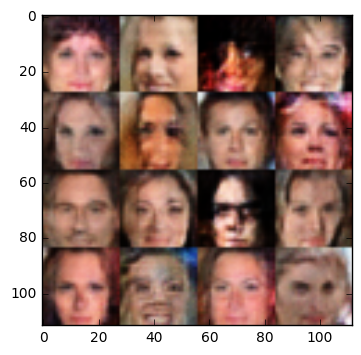

Epoch 0/1... Discriminator Loss: 1.4079... Generator Loss: 0.6079
Epoch 0/1... Discriminator Loss: 1.1393... Generator Loss: 0.7621
Epoch 0/1... Discriminator Loss: 1.3729... Generator Loss: 0.5755
Epoch 0/1... Discriminator Loss: 1.1975... Generator Loss: 0.5684
Epoch 0/1... Discriminator Loss: 1.1759... Generator Loss: 0.6278


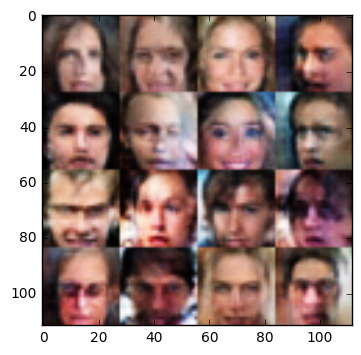

Epoch 0/1... Discriminator Loss: 1.4713... Generator Loss: 0.5321
Epoch 0/1... Discriminator Loss: 1.0822... Generator Loss: 0.7076
Epoch 0/1... Discriminator Loss: 1.3694... Generator Loss: 0.5078
Epoch 0/1... Discriminator Loss: 1.1631... Generator Loss: 0.7310
Epoch 0/1... Discriminator Loss: 1.0894... Generator Loss: 0.8587


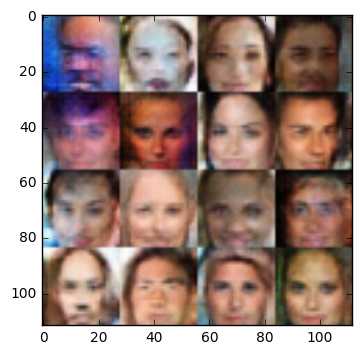

Epoch 0/1... Discriminator Loss: 1.2312... Generator Loss: 0.6087
Epoch 0/1... Discriminator Loss: 1.1762... Generator Loss: 0.6305
Epoch 0/1... Discriminator Loss: 1.4577... Generator Loss: 0.5068
Epoch 0/1... Discriminator Loss: 1.6171... Generator Loss: 0.4047
Epoch 0/1... Discriminator Loss: 1.1709... Generator Loss: 0.7673


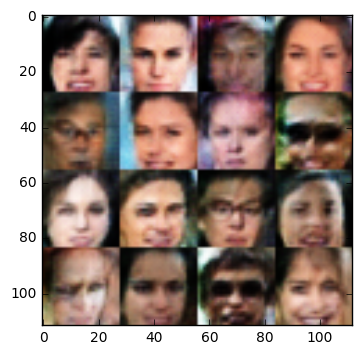

Epoch 0/1... Discriminator Loss: 0.9929... Generator Loss: 0.8902
Epoch 0/1... Discriminator Loss: 1.2538... Generator Loss: 0.5902
Epoch 0/1... Discriminator Loss: 1.3016... Generator Loss: 0.4843
Epoch 0/1... Discriminator Loss: 1.2166... Generator Loss: 0.5876
Epoch 0/1... Discriminator Loss: 1.2921... Generator Loss: 0.6502


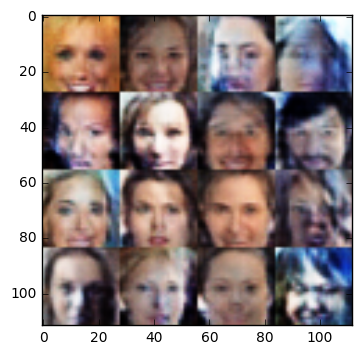

Epoch 0/1... Discriminator Loss: 1.3041... Generator Loss: 0.5146
Epoch 0/1... Discriminator Loss: 1.2995... Generator Loss: 0.5432
Epoch 0/1... Discriminator Loss: 1.2080... Generator Loss: 0.5983
Epoch 0/1... Discriminator Loss: 1.1647... Generator Loss: 0.7092
Epoch 0/1... Discriminator Loss: 1.2029... Generator Loss: 0.7260


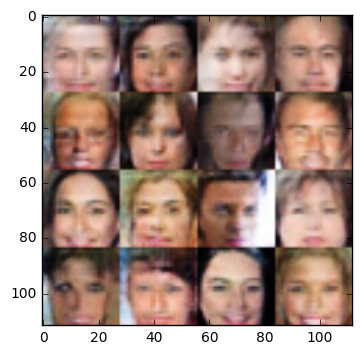

Epoch 0/1... Discriminator Loss: 1.0476... Generator Loss: 0.7500
Epoch 0/1... Discriminator Loss: 1.2653... Generator Loss: 0.6568
Epoch 0/1... Discriminator Loss: 1.2871... Generator Loss: 0.6763
Epoch 0/1... Discriminator Loss: 1.2210... Generator Loss: 0.5445
Epoch 0/1... Discriminator Loss: 1.1411... Generator Loss: 0.7607


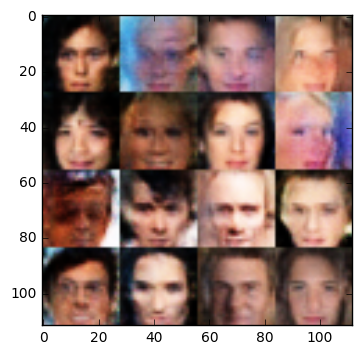

Epoch 0/1... Discriminator Loss: 1.0666... Generator Loss: 0.7867
Epoch 0/1... Discriminator Loss: 1.0344... Generator Loss: 0.7836
Epoch 0/1... Discriminator Loss: 1.4197... Generator Loss: 0.4537
Epoch 0/1... Discriminator Loss: 0.8789... Generator Loss: 0.9451
Epoch 0/1... Discriminator Loss: 1.3583... Generator Loss: 0.6323


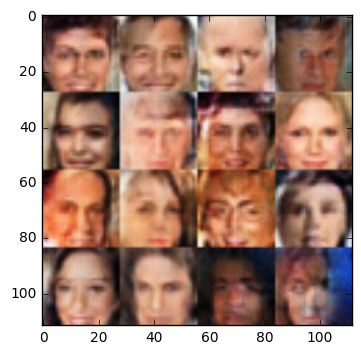

Epoch 0/1... Discriminator Loss: 1.1384... Generator Loss: 0.7281
Epoch 0/1... Discriminator Loss: 1.2506... Generator Loss: 0.6082
Epoch 0/1... Discriminator Loss: 1.2801... Generator Loss: 0.7548
Epoch 0/1... Discriminator Loss: 1.1820... Generator Loss: 0.6558
Epoch 0/1... Discriminator Loss: 1.1303... Generator Loss: 0.6166


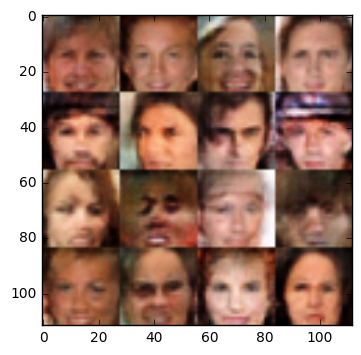

Epoch 0/1... Discriminator Loss: 1.4563... Generator Loss: 0.4771
Epoch 0/1... Discriminator Loss: 1.2520... Generator Loss: 0.5633
Epoch 0/1... Discriminator Loss: 1.2777... Generator Loss: 0.5715
Epoch 0/1... Discriminator Loss: 1.4513... Generator Loss: 0.4811
Epoch 0/1... Discriminator Loss: 1.3917... Generator Loss: 0.5662


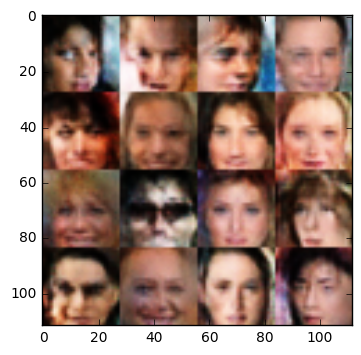

Epoch 0/1... Discriminator Loss: 1.0997... Generator Loss: 0.7511
Epoch 0/1... Discriminator Loss: 1.1664... Generator Loss: 0.7519
Epoch 0/1... Discriminator Loss: 1.3663... Generator Loss: 0.4418
Epoch 0/1... Discriminator Loss: 1.4996... Generator Loss: 0.5051
Epoch 0/1... Discriminator Loss: 1.2602... Generator Loss: 0.5150


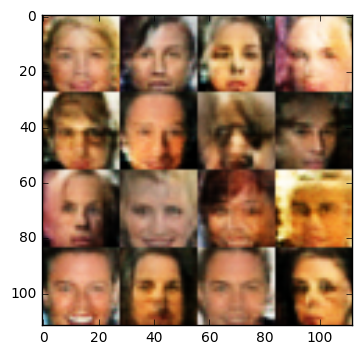

Epoch 0/1... Discriminator Loss: 1.0064... Generator Loss: 0.7151
Epoch 0/1... Discriminator Loss: 1.5245... Generator Loss: 0.3618
Epoch 0/1... Discriminator Loss: 1.3828... Generator Loss: 0.5387
Epoch 0/1... Discriminator Loss: 1.1749... Generator Loss: 0.6557
Epoch 0/1... Discriminator Loss: 1.2091... Generator Loss: 0.7071


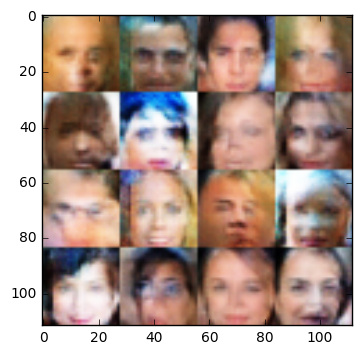

Epoch 0/1... Discriminator Loss: 1.1310... Generator Loss: 0.7733
Epoch 0/1... Discriminator Loss: 1.2554... Generator Loss: 0.7374
Epoch 0/1... Discriminator Loss: 1.3140... Generator Loss: 0.5507
Epoch 0/1... Discriminator Loss: 1.1087... Generator Loss: 0.9452
Epoch 0/1... Discriminator Loss: 1.1905... Generator Loss: 0.6274


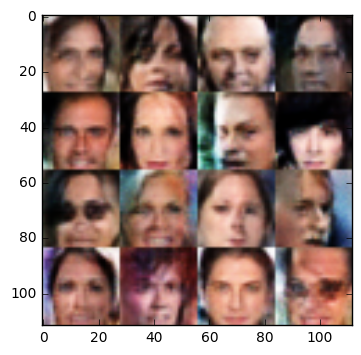

Epoch 0/1... Discriminator Loss: 1.2057... Generator Loss: 0.6243
Epoch 0/1... Discriminator Loss: 1.3663... Generator Loss: 0.6022
Epoch 0/1... Discriminator Loss: 1.4694... Generator Loss: 0.4545
Epoch 0/1... Discriminator Loss: 1.1171... Generator Loss: 0.9061
Epoch 0/1... Discriminator Loss: 1.1409... Generator Loss: 0.6880


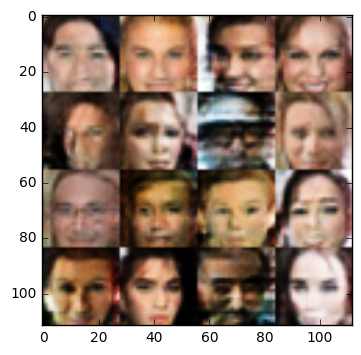

Epoch 0/1... Discriminator Loss: 1.3520... Generator Loss: 0.5073
Epoch 0/1... Discriminator Loss: 1.2511... Generator Loss: 0.6863
Epoch 0/1... Discriminator Loss: 1.4475... Generator Loss: 0.4222
Epoch 0/1... Discriminator Loss: 1.0630... Generator Loss: 0.8457
Epoch 0/1... Discriminator Loss: 1.1730... Generator Loss: 0.5530


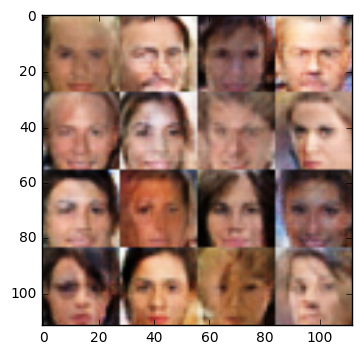

Epoch 0/1... Discriminator Loss: 1.0512... Generator Loss: 0.6814
Epoch 0/1... Discriminator Loss: 1.1454... Generator Loss: 0.6848
Epoch 0/1... Discriminator Loss: 1.3055... Generator Loss: 0.5992
Epoch 0/1... Discriminator Loss: 1.5998... Generator Loss: 0.3564
Epoch 0/1... Discriminator Loss: 1.2170... Generator Loss: 0.6486


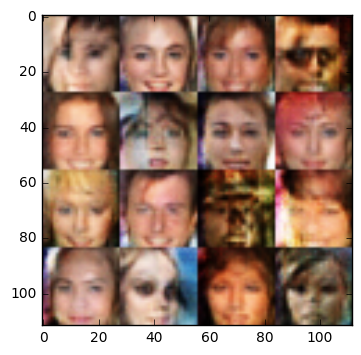

Epoch 0/1... Discriminator Loss: 1.3029... Generator Loss: 0.5692
Epoch 0/1... Discriminator Loss: 1.2196... Generator Loss: 0.5765
Epoch 0/1... Discriminator Loss: 1.5035... Generator Loss: 0.4526
Epoch 0/1... Discriminator Loss: 1.4826... Generator Loss: 0.4141
Epoch 0/1... Discriminator Loss: 1.0962... Generator Loss: 0.7074


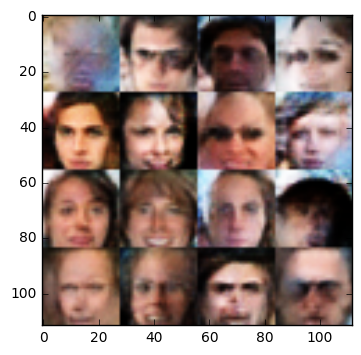

Epoch 0/1... Discriminator Loss: 1.2479... Generator Loss: 0.7000
Epoch 0/1... Discriminator Loss: 1.5168... Generator Loss: 0.4311
Epoch 0/1... Discriminator Loss: 1.1724... Generator Loss: 0.6549
Epoch 0/1... Discriminator Loss: 1.4003... Generator Loss: 0.4355
Epoch 0/1... Discriminator Loss: 1.0535... Generator Loss: 0.6312


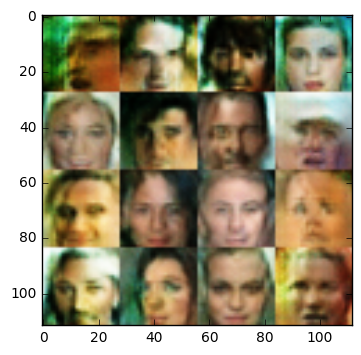

Epoch 0/1... Discriminator Loss: 1.4842... Generator Loss: 0.4389
Epoch 0/1... Discriminator Loss: 0.8572... Generator Loss: 0.8962
Epoch 0/1... Discriminator Loss: 1.1661... Generator Loss: 0.6225
Epoch 0/1... Discriminator Loss: 1.6435... Generator Loss: 0.3812
Epoch 0/1... Discriminator Loss: 1.0060... Generator Loss: 0.8031


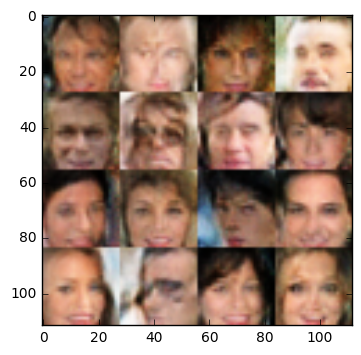

Epoch 0/1... Discriminator Loss: 1.0407... Generator Loss: 1.1305
Epoch 0/1... Discriminator Loss: 1.3034... Generator Loss: 0.5487
Epoch 0/1... Discriminator Loss: 1.2833... Generator Loss: 0.6176
Epoch 0/1... Discriminator Loss: 1.2556... Generator Loss: 0.9107
Epoch 0/1... Discriminator Loss: 1.1436... Generator Loss: 0.7065


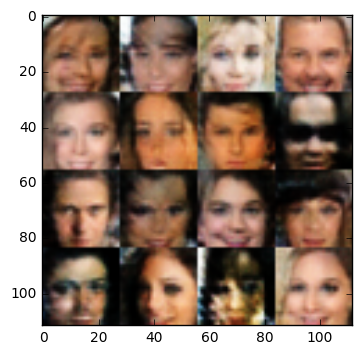

Epoch 0/1... Discriminator Loss: 1.3359... Generator Loss: 0.4662
Epoch 0/1... Discriminator Loss: 1.1372... Generator Loss: 0.7109
Epoch 0/1... Discriminator Loss: 1.4425... Generator Loss: 0.3712
Epoch 0/1... Discriminator Loss: 1.3006... Generator Loss: 0.5240
Epoch 0/1... Discriminator Loss: 1.2834... Generator Loss: 0.5155


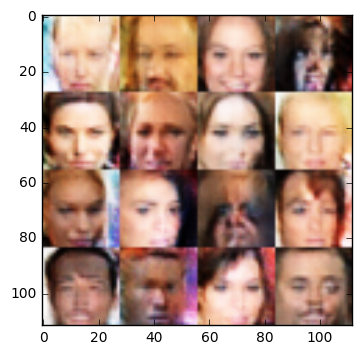

Epoch 0/1... Discriminator Loss: 1.2941... Generator Loss: 0.5293
Epoch 0/1... Discriminator Loss: 1.9372... Generator Loss: 0.2648
Epoch 0/1... Discriminator Loss: 1.4083... Generator Loss: 0.5355
Epoch 0/1... Discriminator Loss: 1.5639... Generator Loss: 0.4484
Epoch 0/1... Discriminator Loss: 1.2588... Generator Loss: 0.6036


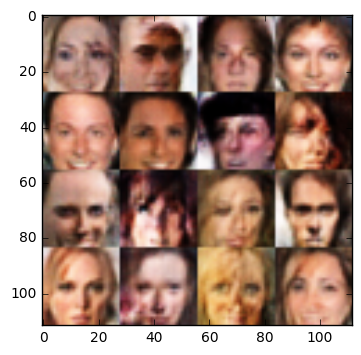

Epoch 0/1... Discriminator Loss: 0.9036... Generator Loss: 0.8199
Epoch 0/1... Discriminator Loss: 1.4354... Generator Loss: 0.4992
Epoch 0/1... Discriminator Loss: 1.2946... Generator Loss: 0.6019
Epoch 0/1... Discriminator Loss: 1.3684... Generator Loss: 0.5784
Epoch 0/1... Discriminator Loss: 1.0953... Generator Loss: 0.8443


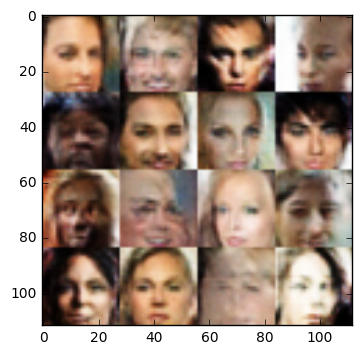

Epoch 0/1... Discriminator Loss: 1.4363... Generator Loss: 0.4908
Epoch 0/1... Discriminator Loss: 1.3652... Generator Loss: 0.7725
Epoch 0/1... Discriminator Loss: 1.1529... Generator Loss: 0.5884
Epoch 0/1... Discriminator Loss: 1.2055... Generator Loss: 0.5599
Epoch 0/1... Discriminator Loss: 1.4231... Generator Loss: 0.4875


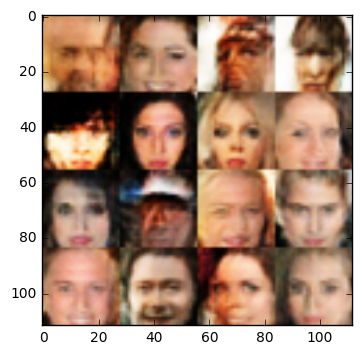

Epoch 0/1... Discriminator Loss: 1.0826... Generator Loss: 0.8162
Epoch 0/1... Discriminator Loss: 1.0362... Generator Loss: 0.8415
Epoch 0/1... Discriminator Loss: 1.4631... Generator Loss: 0.3451
Epoch 0/1... Discriminator Loss: 1.5439... Generator Loss: 0.4589
Epoch 0/1... Discriminator Loss: 1.1689... Generator Loss: 0.6910


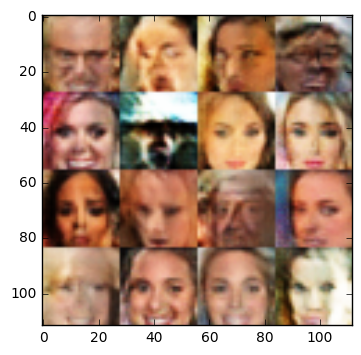

Epoch 0/1... Discriminator Loss: 1.3986... Generator Loss: 0.4731
Epoch 0/1... Discriminator Loss: 1.3739... Generator Loss: 0.6462
Epoch 0/1... Discriminator Loss: 1.5314... Generator Loss: 0.4541
Epoch 0/1... Discriminator Loss: 0.9281... Generator Loss: 0.8853
Epoch 0/1... Discriminator Loss: 1.3750... Generator Loss: 0.5032


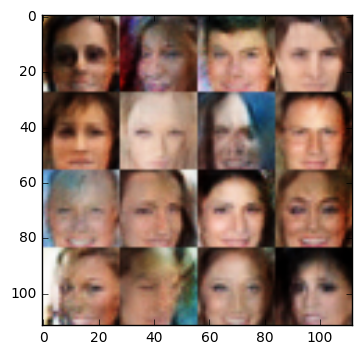

Epoch 0/1... Discriminator Loss: 1.1035... Generator Loss: 0.7657
Epoch 0/1... Discriminator Loss: 1.3503... Generator Loss: 0.4948
Epoch 0/1... Discriminator Loss: 0.8421... Generator Loss: 0.9402
Epoch 0/1... Discriminator Loss: 1.0373... Generator Loss: 0.8891
Epoch 0/1... Discriminator Loss: 1.1879... Generator Loss: 0.7731


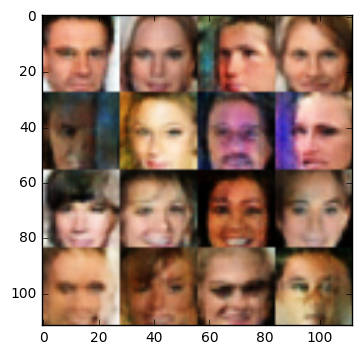

Epoch 0/1... Discriminator Loss: 1.3364... Generator Loss: 0.5427
Epoch 0/1... Discriminator Loss: 1.5435... Generator Loss: 0.4122
Epoch 0/1... Discriminator Loss: 1.3134... Generator Loss: 0.5995
Epoch 0/1... Discriminator Loss: 1.4727... Generator Loss: 0.4529
Epoch 0/1... Discriminator Loss: 1.3696... Generator Loss: 0.4462


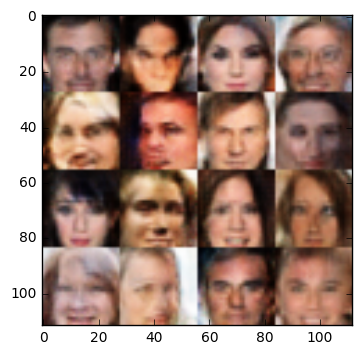

Epoch 0/1... Discriminator Loss: 1.2097... Generator Loss: 0.6234
Epoch 0/1... Discriminator Loss: 0.9477... Generator Loss: 0.7919
Epoch 0/1... Discriminator Loss: 0.8700... Generator Loss: 0.8712
Epoch 0/1... Discriminator Loss: 1.4339... Generator Loss: 0.5060
Epoch 0/1... Discriminator Loss: 1.3737... Generator Loss: 0.4808


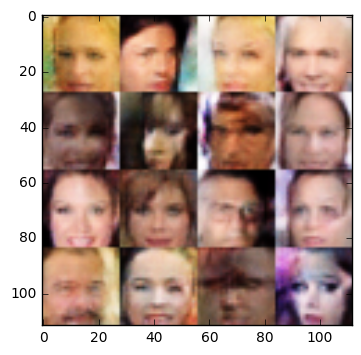

Epoch 0/1... Discriminator Loss: 1.5103... Generator Loss: 0.3660
Epoch 0/1... Discriminator Loss: 1.3719... Generator Loss: 0.5985
Epoch 0/1... Discriminator Loss: 1.3299... Generator Loss: 0.5475
Epoch 0/1... Discriminator Loss: 1.0289... Generator Loss: 0.6799
Epoch 0/1... Discriminator Loss: 1.1468... Generator Loss: 0.6700


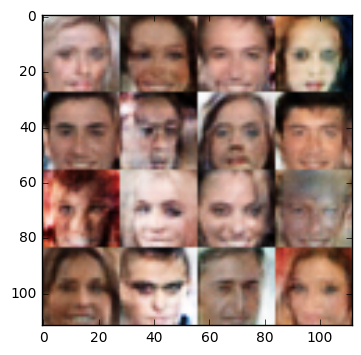

Epoch 0/1... Discriminator Loss: 1.2276... Generator Loss: 0.5983
Epoch 0/1... Discriminator Loss: 1.6461... Generator Loss: 0.3441
Epoch 0/1... Discriminator Loss: 1.2887... Generator Loss: 0.5783
Epoch 0/1... Discriminator Loss: 1.0958... Generator Loss: 0.6449
Epoch 0/1... Discriminator Loss: 1.2786... Generator Loss: 0.5483


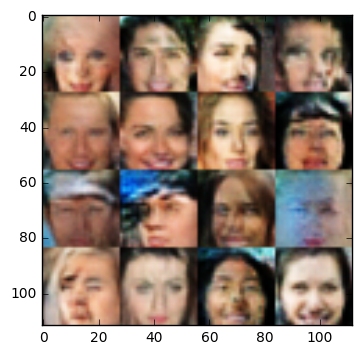

Epoch 0/1... Discriminator Loss: 1.4723... Generator Loss: 0.3912
Epoch 0/1... Discriminator Loss: 1.2462... Generator Loss: 0.5498
Epoch 0/1... Discriminator Loss: 1.3928... Generator Loss: 0.4528
Epoch 0/1... Discriminator Loss: 1.2746... Generator Loss: 0.6700
Epoch 0/1... Discriminator Loss: 1.1698... Generator Loss: 0.6226


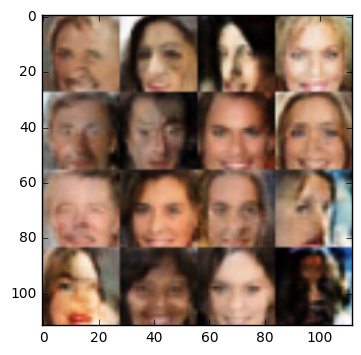

Epoch 0/1... Discriminator Loss: 1.3799... Generator Loss: 0.4814
Epoch 0/1... Discriminator Loss: 1.0470... Generator Loss: 0.8258
Epoch 0/1... Discriminator Loss: 1.5405... Generator Loss: 0.5395
Epoch 0/1... Discriminator Loss: 1.3859... Generator Loss: 0.5571
Epoch 0/1... Discriminator Loss: 1.2066... Generator Loss: 0.6492


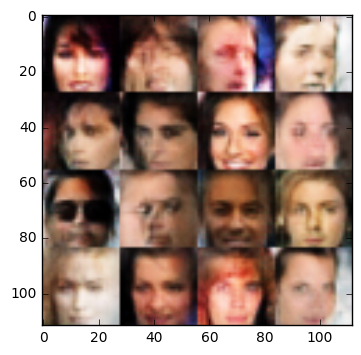

Epoch 0/1... Discriminator Loss: 1.0419... Generator Loss: 0.7701
Epoch 0/1... Discriminator Loss: 1.3283... Generator Loss: 0.4653
Epoch 0/1... Discriminator Loss: 1.3783... Generator Loss: 0.4737
Epoch 0/1... Discriminator Loss: 1.8269... Generator Loss: 0.3321
Epoch 0/1... Discriminator Loss: 1.3134... Generator Loss: 0.5374


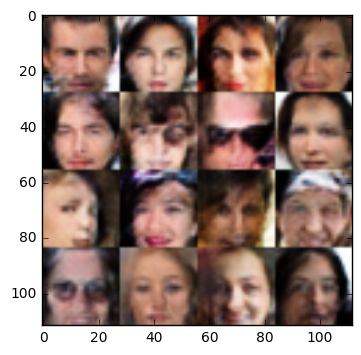

Epoch 0/1... Discriminator Loss: 1.8135... Generator Loss: 0.2683
Epoch 0/1... Discriminator Loss: 1.0827... Generator Loss: 0.7010
Epoch 0/1... Discriminator Loss: 1.4127... Generator Loss: 0.5287
Epoch 0/1... Discriminator Loss: 1.4324... Generator Loss: 0.4068
Epoch 0/1... Discriminator Loss: 0.9692... Generator Loss: 0.7928


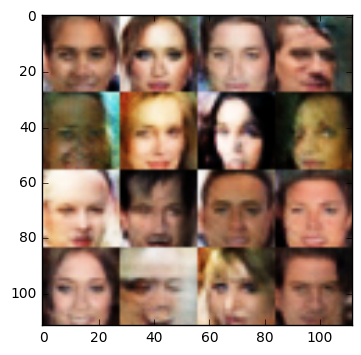

Epoch 0/1... Discriminator Loss: 1.4175... Generator Loss: 0.4766
Epoch 0/1... Discriminator Loss: 1.4442... Generator Loss: 0.4617
Epoch 0/1... Discriminator Loss: 1.0953... Generator Loss: 0.7865
Epoch 0/1... Discriminator Loss: 1.3400... Generator Loss: 0.5351
Epoch 0/1... Discriminator Loss: 1.0597... Generator Loss: 0.8805


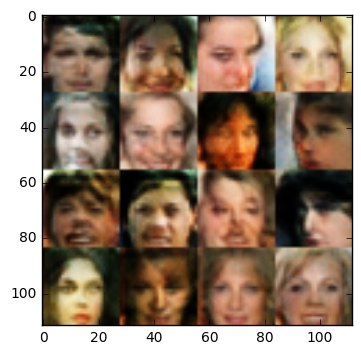

Epoch 0/1... Discriminator Loss: 1.2166... Generator Loss: 0.7715
Epoch 0/1... Discriminator Loss: 1.1264... Generator Loss: 0.6272
Epoch 0/1... Discriminator Loss: 0.9627... Generator Loss: 0.7825
Epoch 0/1... Discriminator Loss: 1.4188... Generator Loss: 0.5193


In [13]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.

References:
https://github.com/udacity/deep-learning
https://github.com/davismartin/uda-deep-learning-fundamentals
https://classroom.udacity.com/nanodegrees/nd101/ - Generator and Discriminator 

Variety of other git repos.